In [1]:
import scvelo as scv #0.3.2 enable CBDir computation
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pygot


In [2]:
%matplotlib inline

In [3]:

plt.rcParams['font.sans-serif'] = "Arial"

In [4]:

def cosine(x, y):
    return np.sum(x * y, axis=1) / (np.linalg.norm(x, axis=1) * np.linalg.norm(y, axis=1))

def score_cell_by_tree(adata, cell_type_key, start_cell_type, tree, vis_key):
    x0 = adata[adata.obs[cell_type_key] == start_cell_type].obsm['X_'+vis_key]
    x0_mean = np.mean(x0, axis=0)
    v_tuple = []
    coses=[]
    for cell_type in tree[start_cell_type]:
        x1 = adata[adata.obs[cell_type_key] == cell_type].obsm['X_'+vis_key]
        v_tuple.append(np.mean(x1, axis=0) - x0_mean)
    v_tuple = np.array(v_tuple)
    v_hat = adata[adata.obs[cell_type_key] == start_cell_type].obsm['velocity_'+vis_key]
    for i in range(v_tuple.shape[0]):
        coses.append(cosine(v_hat, v_tuple[i][None,:]))
    score = np.max(np.array(coses), axis=0)
    adata.obs.loc[adata[adata.obs[cell_type_key] == start_cell_type].obs.index, 'score'] = score
    return score

In [5]:
#CBDir from UniTVelo package
"""
Evaluation utility functions.
This module contains util functions for computing evaluation scores.
"""

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def summary_scores(all_scores):
    """Summarize group scores.
    
    Args:
        all_scores (dict{str,list}): 
            {group name: score list of individual cells}.
    
    Returns:
        dict{str,float}: 
            Group-wise aggregation scores.
        float: 
            score aggregated on all samples
        
    """
    sep_scores = {k:np.mean(s) for k, s in all_scores.items() if s}
    overal_agg = np.mean([s for k, s in sep_scores.items() if s])
    return sep_scores, overal_agg

def keep_type(adata, nodes, target, k_cluster):
    """Select cells of targeted type
    
    Args:
        adata (Anndata): 
            Anndata object.
        nodes (list): 
            Indexes for cells
        target (str): 
            Cluster name.
        k_cluster (str): 
            Cluster key in adata.obs dataframe

    Returns:
        list: 
            Selected cells.

    """
    return nodes[adata.obs[k_cluster][nodes].values == target]

def cross_boundary_correctness(
    adata, 
    k_cluster, 
    k_velocity, 
    cluster_edges, 
    return_raw=False, 
    x_emb="X_umap"
):
    """Cross-Boundary Direction Correctness Score (A->B)
    
    Args:
        adata (Anndata): 
            Anndata object.
        k_cluster (str): 
            key to the cluster column in adata.obs DataFrame.
        k_velocity (str): 
            key to the velocity matrix in adata.obsm.
        cluster_edges (list of tuples("A", "B")): 
            pairs of clusters has transition direction A->B
        return_raw (bool): 
            return aggregated or raw scores.
        x_emb (str): 
            key to x embedding for visualization.
        
    Returns:
        dict: 
            all_scores indexed by cluster_edges or mean scores indexed by cluster_edges
        float: 
            averaged score over all cells.
        
    """
    scores = {}
    all_scores = {}
    v_emb = adata.obsm['velocity_' + x_emb.split('_')[1]]
    x_emb = adata.obsm[x_emb]

      
    for u, v in cluster_edges:
        sel = adata.obs[k_cluster] == u
        nbs = adata.uns['neighbors']['indices'][sel] # [n * 30]
        
        boundary_nodes = map(lambda nodes:keep_type(adata, nodes, v, k_cluster), nbs)
        x_points = x_emb[sel]
        x_velocities = v_emb[sel]
        
        type_score = []
        for x_pos, x_vel, nodes in zip(x_points, x_velocities, boundary_nodes):
            if len(nodes) == 0: continue

            position_dif = x_emb[nodes] - x_pos
            dir_scores = cosine_similarity(position_dif, x_vel.reshape(1,-1)).flatten()
            type_score.append(np.mean(dir_scores))
        
        scores[(u, v)] = np.mean(type_score)
        all_scores[(u, v)] = type_score
        
    if return_raw:
        return all_scores 
    
    return scores, np.mean([sc for sc in scores.values()])

def inner_cluster_coh(adata, k_cluster, k_velocity, return_raw=False):
    """In-cluster Coherence Score.
    
    Args:
        adata (Anndata): 
            Anndata object.
        k_cluster (str): 
            key to the cluster column in adata.obs DataFrame.
        k_velocity (str): 
            key to the velocity matrix in adata.obsm.
        return_raw (bool): 
            return aggregated or raw scores.
        
    Returns:
        dict: 
            all_scores indexed by cluster_edges mean scores indexed by cluster_edges
        float: 
            averaged score over all cells.
        
    """
    clusters = np.unique(adata.obs[k_cluster])
    scores = {}
    all_scores = {}

    for cat in clusters:
        sel = adata.obs[k_cluster] == cat
        nbs = adata.uns['neighbors']['indices'][sel]
        same_cat_nodes = map(lambda nodes:keep_type(adata, nodes, cat, k_cluster), nbs)

        velocities = adata.layers[k_velocity]
        cat_vels = velocities[sel]
        cat_score = [cosine_similarity(cat_vels[[ith]], velocities[nodes]).mean() 
                     for ith, nodes in enumerate(same_cat_nodes) 
                     if len(nodes) > 0]
        all_scores[cat] = cat_score
        scores[cat] = np.mean(cat_score)
    
    if return_raw:
        return all_scores
    
    return scores, np.mean([sc for sc in scores.values()])

def evaluate(
    adata, 
    cluster_edges, 
    k_cluster, 
    k_velocity="velocity", 
    x_emb="X_umap", 
    verbose=True
):
    """Evaluate velocity estimation results using 5 metrics.
    
    Args:
        adata (Anndata): 
            Anndata object.
        cluster_edges (list of tuples("A", "B")): 
            pairs of clusters has transition direction A->B
        k_cluster (str): 
            key to the cluster column in adata.obs DataFrame.
        k_velocity (str): 
            key to the velocity matrix in adata.obsm.
        x_emb (str): 
            key to x embedding for visualization.
        
    Returns:
        dict: 
            aggregated metric scores.
    
    """

    from .eval_utils import cross_boundary_correctness
    from .eval_utils import inner_cluster_coh
    crs_bdr_crc = cross_boundary_correctness(adata, k_cluster, k_velocity, cluster_edges, True, x_emb)
    ic_coh = inner_cluster_coh(adata, k_cluster, k_velocity, True)
    
    if verbose:
        print("# Cross-Boundary Direction Correctness (A->B)\n{}\nTotal Mean: {}".format(*summary_scores(crs_bdr_crc)))
        print("# In-cluster Coherence\n{}\nTotal Mean: {}".format(*summary_scores(ic_coh)))
    
    return {
        "Cross-Boundary Direction Correctness (A->B)": crs_bdr_crc,
        "In-cluster Coherence": ic_coh,
    }

In [6]:
def calculate_cluster_centres(data, cluster_labels):

    unique_labels = np.unique(cluster_labels)
    

    cluster_centres = {}
    
    for label in unique_labels:
        cluster_points = data[cluster_labels == label]
        
        cluster_centre = cluster_points.mean(axis=0)
        cluster_centres[label] = cluster_centre
    
    return cluster_centres

In [7]:
def plot_mst(adata, mst_children, cell_type_key,  basis='umap', ax=None):
        data = adata.obsm['X_' + basis]
        cluster_labels = adata.obs[cell_type_key].to_numpy()
        cluster_centres = calculate_cluster_centres(data, cluster_labels)
        if ax is None:
            fig, ax = plt.subplots(1, 1, )

        sc.pl.embedding(adata, color=cell_type_key, legend_loc='on data', basis=basis, ax=ax, show=False, frameon=False)
        start_node_indicator = {i : True for i in mst_children }
        

        for root, kids in mst_children.items():
            for child in kids:
                start_node_indicator[child] = False
                x_coords = [cluster_centres[root][0], cluster_centres[child][0]]
                y_coords = [cluster_centres[root][1], cluster_centres[child][1]]
                ax.plot(x_coords, y_coords, 'k-')
                ax.arrow(x_coords[-2], y_coords[-2], x_coords[-1] - x_coords[-2], y_coords[-1] -  y_coords[-2], head_width=1.0, fc='red', ec='red', length_includes_head=True,)

        
        
        

## Pancreas

  0%|          | 0.00/50.0M [00:00<?, ?B/s]

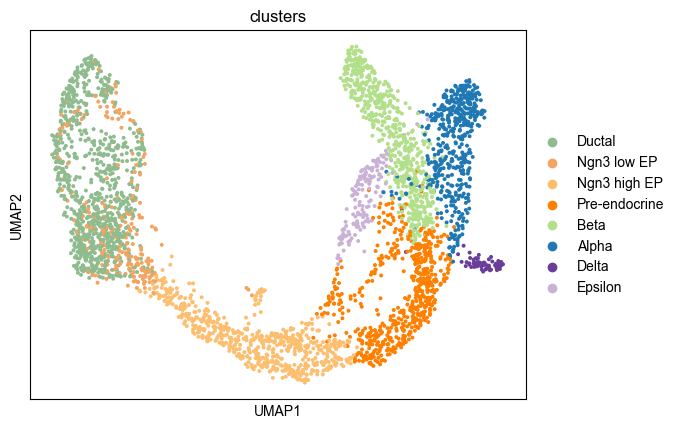

In [8]:
adata = scv.datasets.pancreas()
sc.pl.umap(adata, color='clusters')

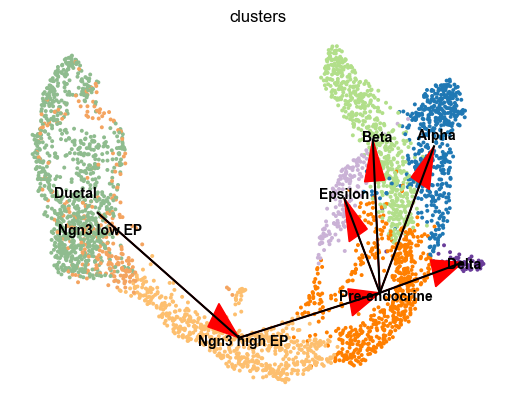

In [9]:
tree = {
    
    'Ngn3 low EP':['Ngn3 high EP'],
    'Ngn3 high EP':['Pre-endocrine'],
    'Pre-endocrine':['Alpha', 'Beta', 'Delta', 'Epsilon'],
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
plot_mst(adata, tree, cell_type_key='clusters',  basis='umap')

In [10]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 20801 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 00:19:19	 Using extrema in diffmap space to connect the whole graph
2025-05-07 00:19:19	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [24:18<00:00,  2.06it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 00:43:52	 Determine linear progress or not..
2025-05-07 00:43:52	 Single Branch Progress : False


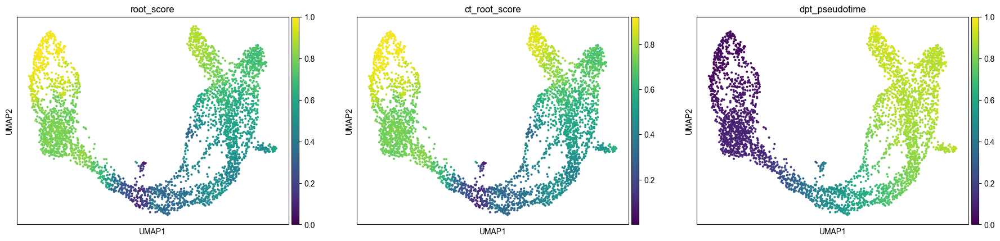

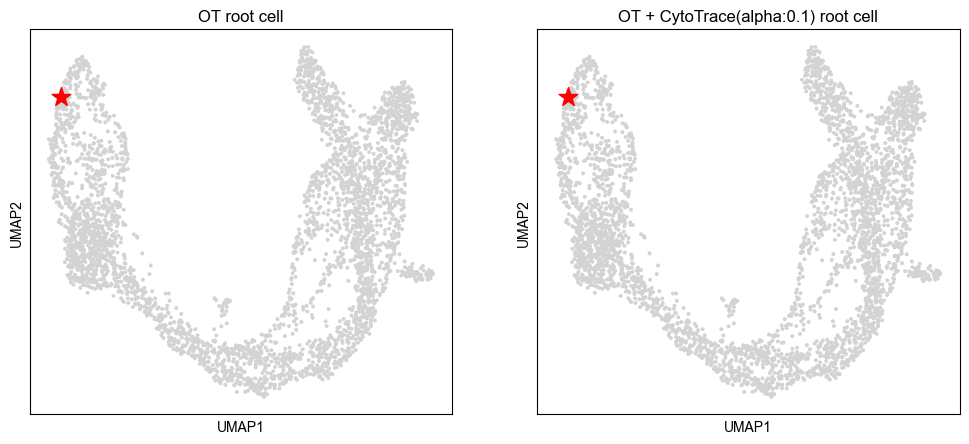

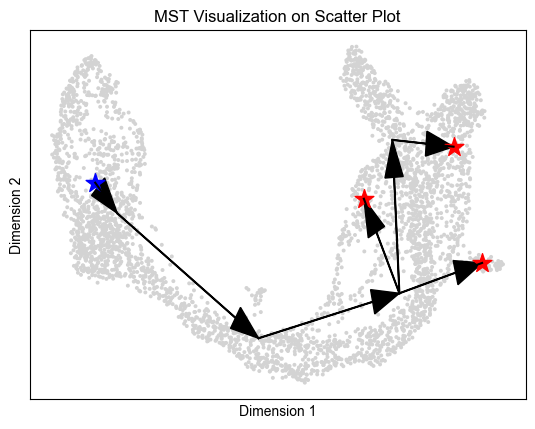

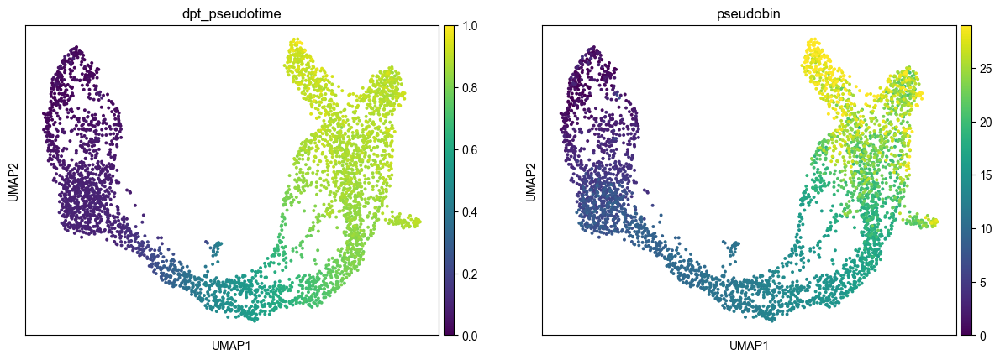

2025-05-07 00:43:53	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 2509.50it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 3393.54it/s]

calcu shortest path between 2.0 to 3.0



100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 3468.63it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 3405.74it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 3488.95it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 3484.13it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 2456.13it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3382.02it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3417.14it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3466.20it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3504.92it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3480.16it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3419.34it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3417.34it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3408.72it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3549.14it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 2462.08it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3517.13it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3563.11it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3079.41it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3543.07it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3505.51it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3510.74it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3473.39it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3503.89it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3498.50it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 3468.16it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 123/123 [00:00<00:00, 2414.55it/s]


calcu shortest path between 28.0 to 29.0


loss :2103.0536  best :2103.0536: 100%|█████████████████████████████████████████████| 200/200 [00:53<00:00,  3.75it/s]


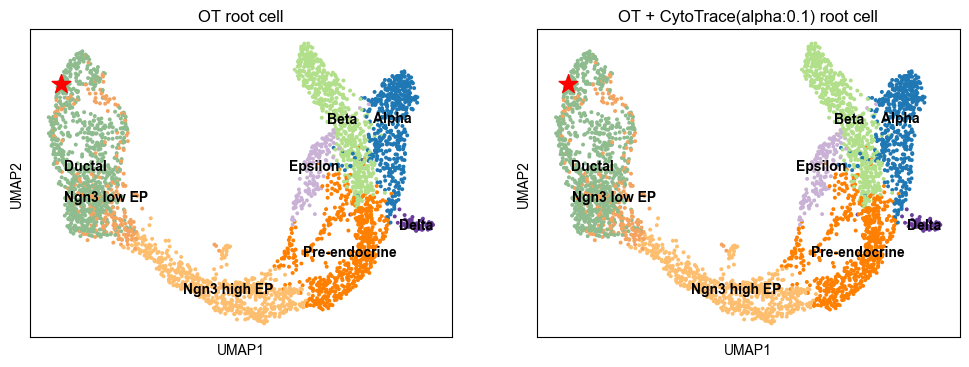

In [11]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'

model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key='clusters', kernel='dpt', 
                                  cytotrace=True, plot=True, basis='umap',)
pygot.pl.plot_root_cell(adata, color='clusters', basis='umap', figsize=(12,4))

In [12]:
vis_key = 'umap'
cell_type_key = 'clusters'
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


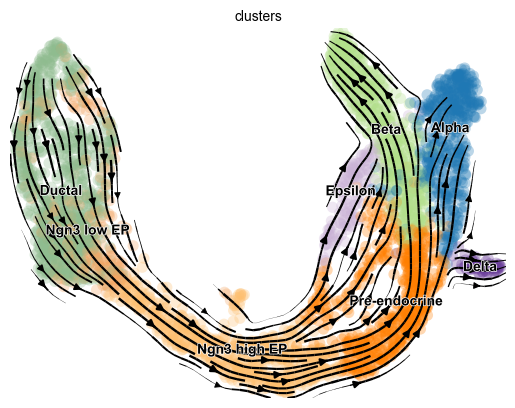

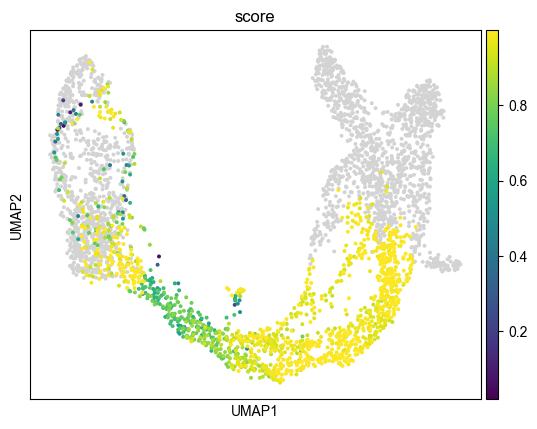

cbc 0.651516852504305
base 0.911795982342013


In [13]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata,  basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)
for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)

In [14]:
cf = pygot.tl.analysis.CellFate()
cf.fit(adata, embedding_key='X_pca', velocity_key='velocity_pca', cell_type_key='clusters', target_cell_types=['Beta', 'Alpha', 'Delta', 'Epsilon'])

2025-05-07 00:46:18 	 Compute transition roadmap among [0 1]
2025-05-07 00:46:18 	 Compute transition between 0 and 1
2025-05-07 00:46:19 	 Compute velocity graph
Scale factor: 1.6477494
Scale factor: 1.6477494
2025-05-07 00:46:21 	 Convert into markov chain
2025-05-07 00:46:21 	 Solve abosorbing probabilities
2025-05-07 00:46:21 	 Generate NULL distribution
Export result into adata.obsm['descendant'] and adata.obsm['ancestor']


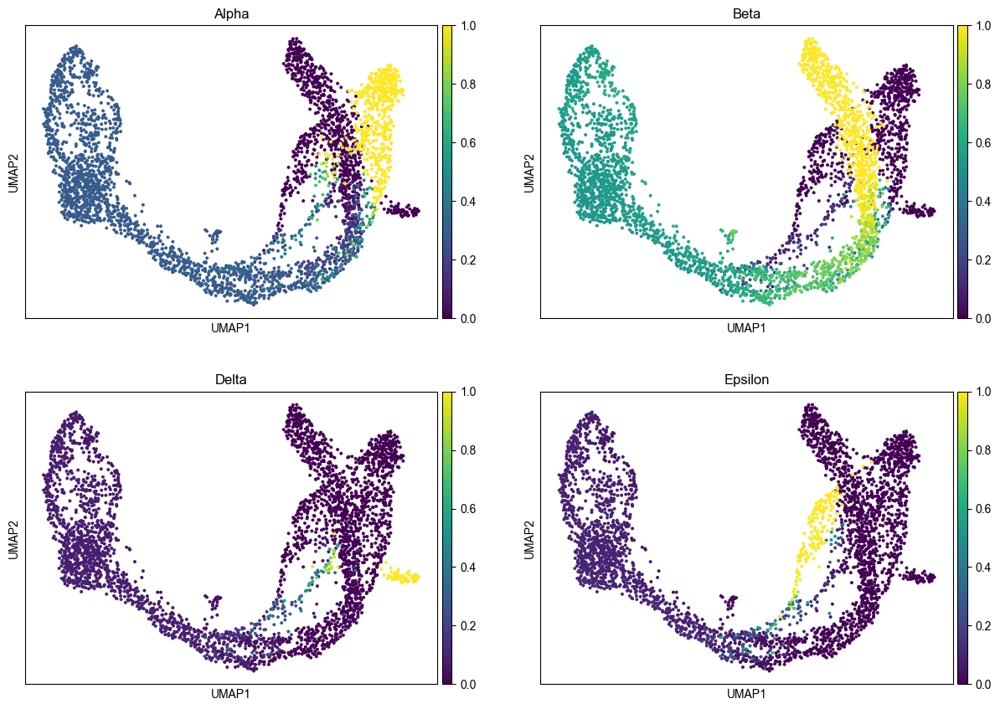

In [15]:
adata.obs[adata.obsm['descendant'].columns] = adata.obsm['descendant']
sc.pl.umap(adata, color=adata.obsm['descendant'].columns, ncols=2)

In [16]:
sc.write('./results/06_snapshot/pancreas/adata_res.h5ad', adata)

In [17]:
np.save('./results/06_snapshot/pancreas/got_umap.npy', adata.obsm['velocity_umap'])
np.save('./results/06_snapshot/pancreas/got.npy', adata.layers['velocity'])


  0%|          | 0/3696 [00:00<?, ?cell/s]

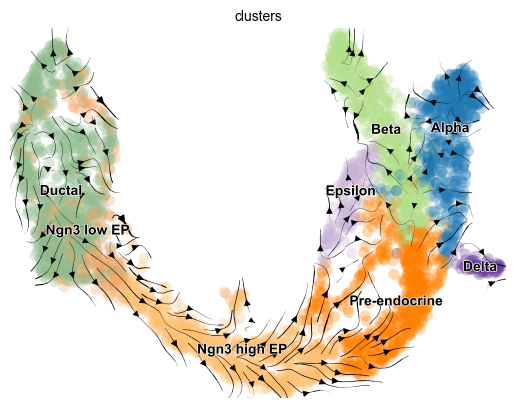

In [18]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key)

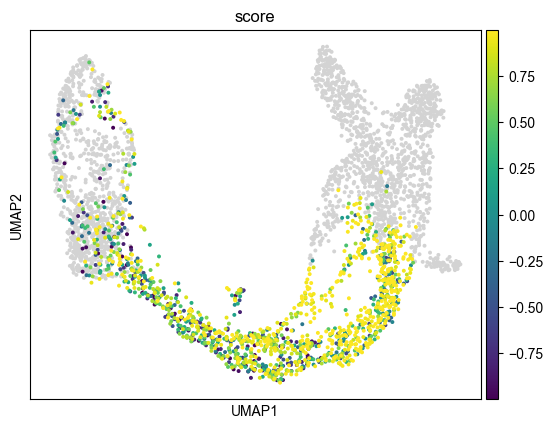

cbc 0.15111963
base 0.4566825047670895


In [19]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/pancreas/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])

## Bonemarrow

  0%|          | 0.00/162M [00:00<?, ?B/s]

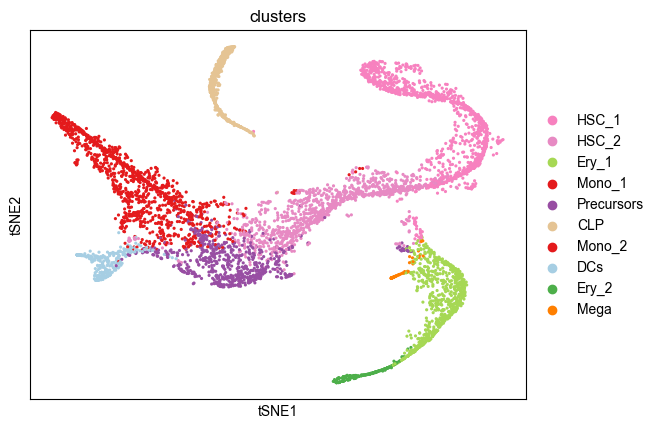

In [20]:
adata = scv.datasets.bonemarrow()
sc.pl.tsne(adata, color='clusters')

[('HSC_1', 'HSC_2'), ('HSC_2', 'Ery_1'), ('HSC_2', 'Precursors'), ('HSC_2', 'CLP'), ('Ery_1', 'Ery_2'), ('Ery_1', 'Mega'), ('Precursors', 'Mono_1'), ('Precursors', 'Mono_2'), ('Precursors', 'DCs')]


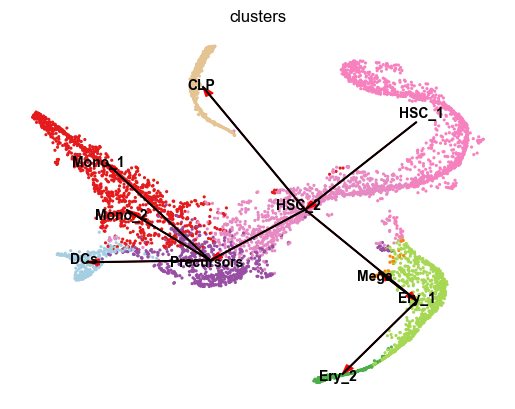

In [21]:
tree = {
    'HSC_1':['HSC_2'],
    'HSC_2':['Ery_1', 'Precursors', 'CLP'],
    'Ery_1':['Ery_2', 'Mega'],
    'Precursors':['Mono_1', 'Mono_2', 'DCs'],
    
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='clusters',  basis='tsne')

In [22]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 7837 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 02:35:43	 Using extrema in diffmap space to connect the whole graph
2025-05-07 02:35:45	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [14:48<00:00,  3.38it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 02:50:46	 Determine linear progress or not..
2025-05-07 02:50:46	 Single Branch Progress : False


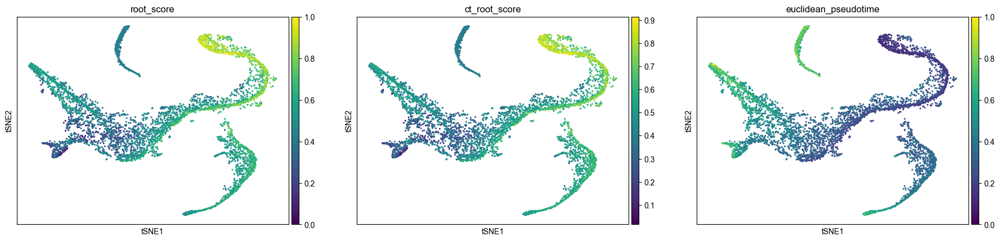

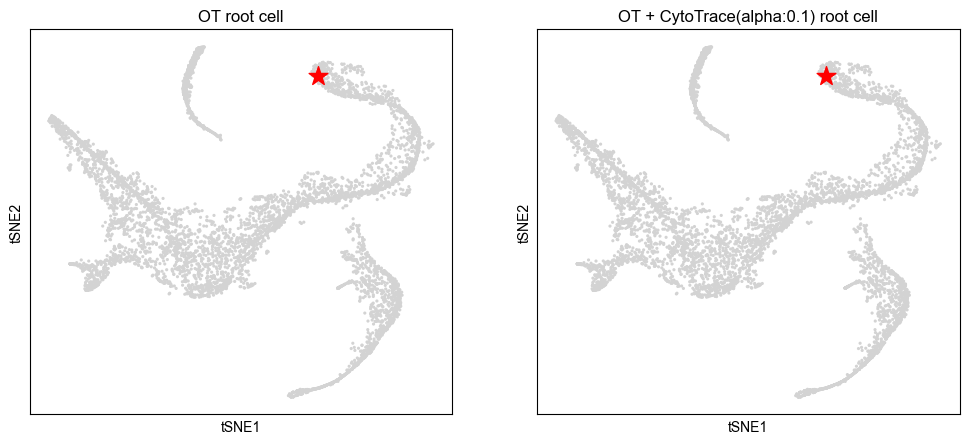

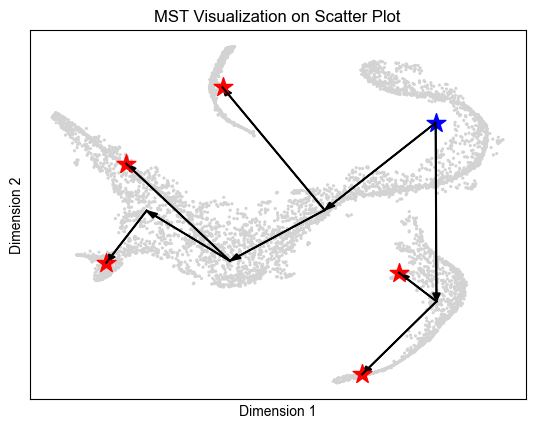

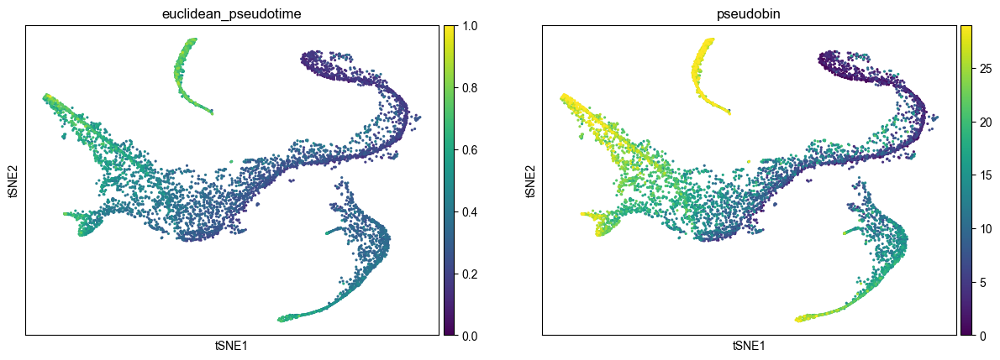

2025-05-07 02:50:47	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2714.87it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2670.33it/s]


calcu shortest path between 2.0 to 3.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2718.95it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2714.89it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2174.57it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2757.08it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2767.29it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2752.03it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2811.98it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2795.05it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2348.26it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2078.41it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2784.36it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2795.83it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2785.26it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2148.96it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2767.47it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 2226.47it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 3083.80it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 193/193 [00:00<00:00, 3034.33it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 2963.19it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 3023.73it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 2967.13it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 2752.02it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 3825.54it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 3531.61it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 3627.80it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 192/192 [00:00<00:00, 2975.54it/s]


calcu shortest path between 28.0 to 29.0


loss :561.8328  best :561.8328: 100%|███████████████████████████████████████████████| 200/200 [00:52<00:00,  3.83it/s]


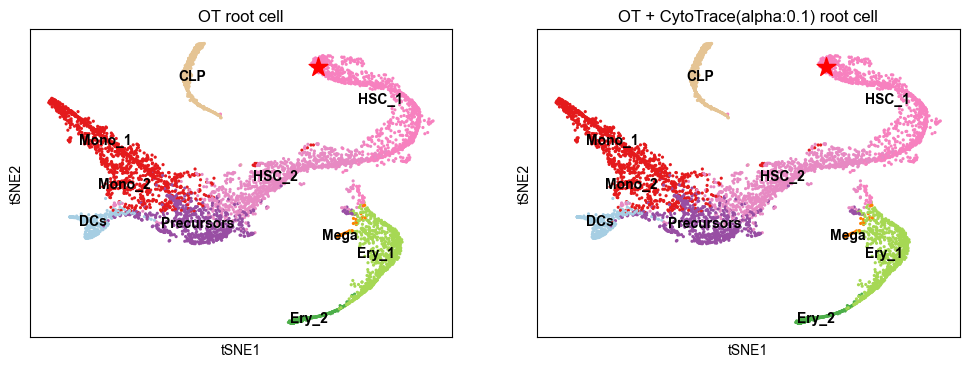

In [23]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'

model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key='clusters', kernel='euclidean',
                                  cytotrace=True,  plot=True, basis='tsne',
                                 )
pygot.pl.plot_root_cell(adata, color='clusters', basis='tsne', figsize=(12,4))

In [24]:
sc.write('./results/06_snapshot/bonemarrow/adata_res.h5ad', adata)

In [25]:
cell_type_key = 'clusters'
vis_key = 'tsne'

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


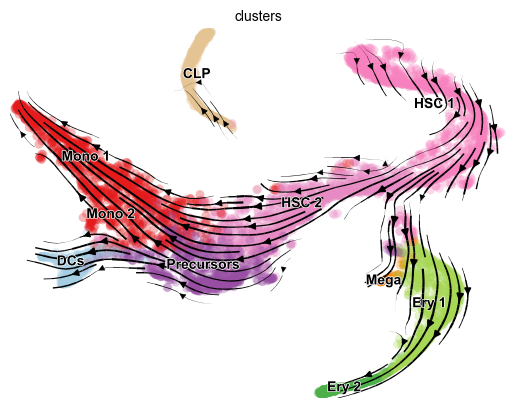

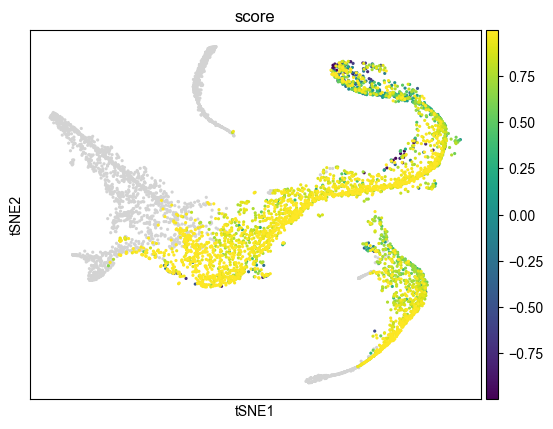

cbc 0.5760555943161866
base 0.7562617686166624


In [26]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key)
scv.pl.velocity_embedding_stream(adata,  basis=vis_key)

_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)

In [27]:
np.save('./results/06_snapshot/bonemarrow/got_tsne.npy', adata.obsm['velocity_tsne'])
np.save('./results/06_snapshot/bonemarrow/got.npy', adata.layers['velocity'])

  0%|          | 0/5780 [00:00<?, ?cell/s]

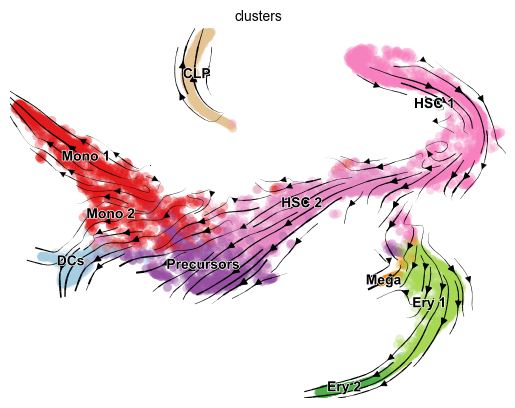

In [28]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='palantir_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

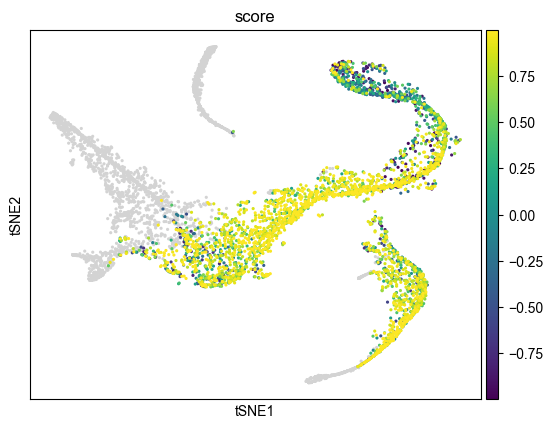

cbc 0.18868955595706813
base 0.48096755196017416


In [29]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/bonemarrow/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


## Dentategyrus

  0%|          | 0.00/23.7M [00:00<?, ?B/s]

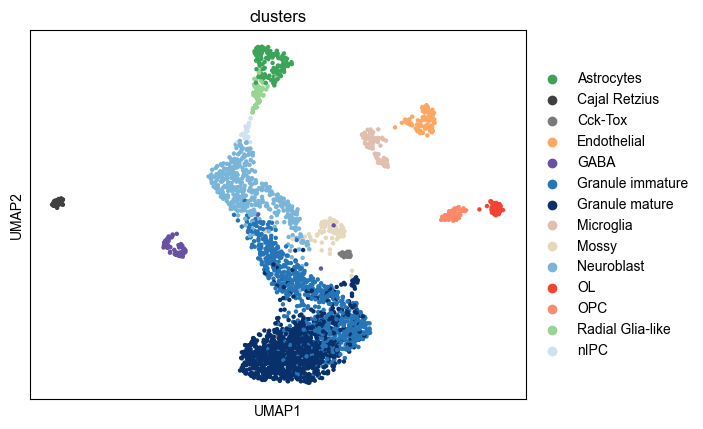

In [30]:
adata = scv.datasets.dentategyrus()
sc.pl.umap(adata, color='clusters')

[('nIPC', 'Radial Glia-like'), ('nIPC', 'Neuroblast'), ('Neuroblast', 'Granule immature'), ('Granule immature', 'Granule mature'), ('Radial Glia-like', 'Astrocytes'), ('OPC', 'OL')]


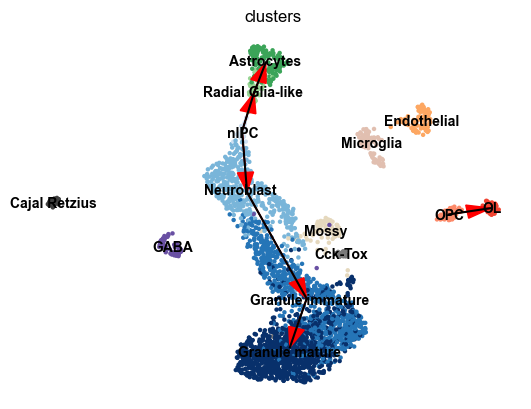

In [31]:
tree = {
    'nIPC':['Radial Glia-like', 'Neuroblast'],
    'Neuroblast':['Granule immature'],
    'Granule immature': [ 'Granule mature'],
    'Radial Glia-like':['Astrocytes'],
    'OPC':['OL'],
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='clusters',  basis='umap')

In [32]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 10340 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 03:07:36	 Using extrema in diffmap space to connect the whole graph
2025-05-07 03:07:36	 Search for the best source cell..
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 2930/2930 [14:04<00:00,  3.47it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 03:21:52	 Determine linear progress or not..
2025-05-07 03:21:52	 Single Branch Progress : False


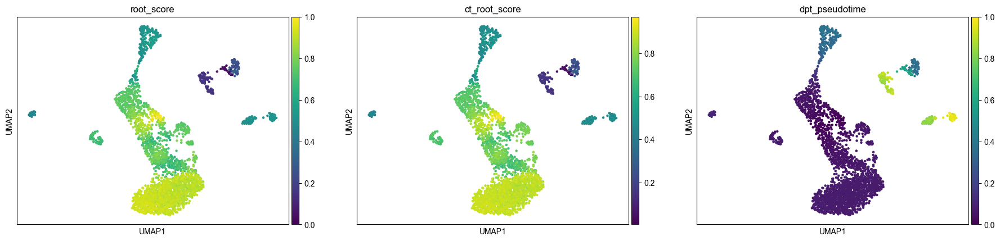

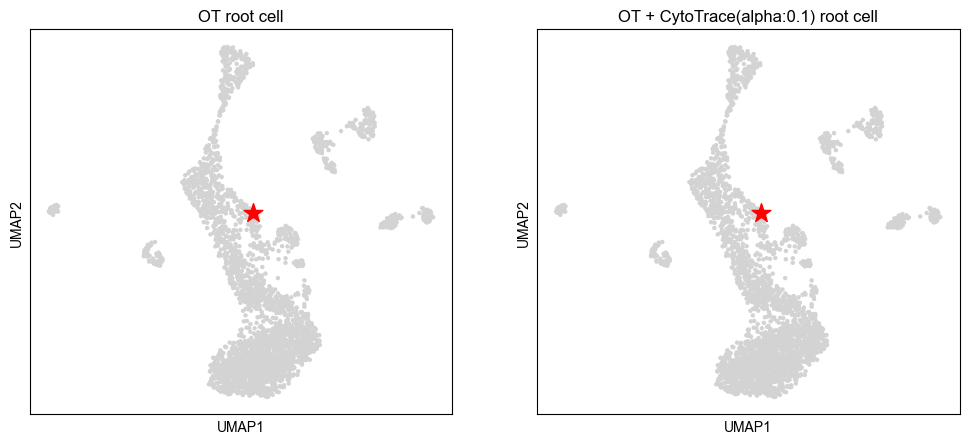

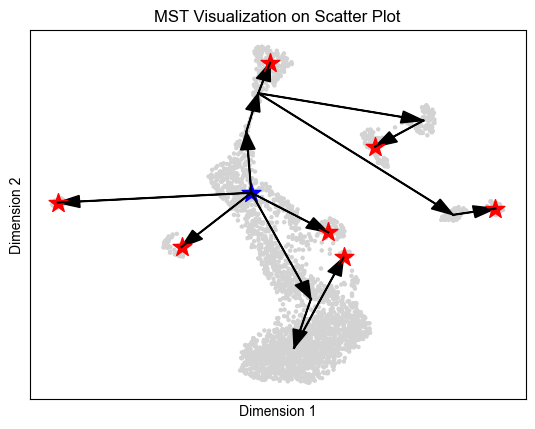

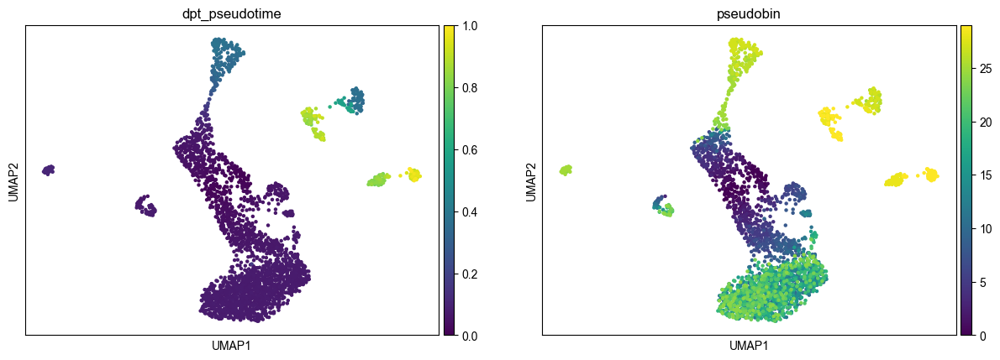

2025-05-07 03:21:53	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3735.79it/s]


calcu shortest path between 1.0 to 2.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3817.00it/s]


calcu shortest path between 2.0 to 3.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4358.97it/s]


calcu shortest path between 3.0 to 4.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4026.23it/s]


calcu shortest path between 4.0 to 5.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4936.43it/s]


calcu shortest path between 5.0 to 6.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4901.64it/s]


calcu shortest path between 6.0 to 7.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4363.45it/s]


calcu shortest path between 7.0 to 8.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4270.87it/s]


calcu shortest path between 8.0 to 9.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4105.25it/s]


calcu shortest path between 9.0 to 10.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 4048.08it/s]


calcu shortest path between 10.0 to 11.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3887.51it/s]


calcu shortest path between 11.0 to 12.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3953.01it/s]


calcu shortest path between 12.0 to 13.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3827.49it/s]


calcu shortest path between 13.0 to 14.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3868.77it/s]


calcu shortest path between 14.0 to 15.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3995.31it/s]


calcu shortest path between 15.0 to 16.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3948.38it/s]


calcu shortest path between 16.0 to 17.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3961.58it/s]


calcu shortest path between 17.0 to 18.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3821.33it/s]


calcu shortest path between 18.0 to 19.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 2440.94it/s]


calcu shortest path between 19.0 to 20.0


100%|███████████████████████████████████████████████████████████████████████████████| 98/98 [00:00<00:00, 3576.27it/s]


calcu shortest path between 20.0 to 21.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 2740.45it/s]


calcu shortest path between 21.0 to 22.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 4026.60it/s]


calcu shortest path between 22.0 to 23.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 4074.18it/s]


calcu shortest path between 23.0 to 24.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 4407.50it/s]


calcu shortest path between 24.0 to 25.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 3660.15it/s]


calcu shortest path between 25.0 to 26.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 3943.77it/s]


calcu shortest path between 26.0 to 27.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 4192.49it/s]


calcu shortest path between 27.0 to 28.0


100%|███████████████████████████████████████████████████████████████████████████████| 97/97 [00:00<00:00, 3728.82it/s]


calcu shortest path between 28.0 to 29.0


loss :6295.3846  best :6295.3846: 100%|█████████████████████████████████████████████| 200/200 [00:54<00:00,  3.68it/s]


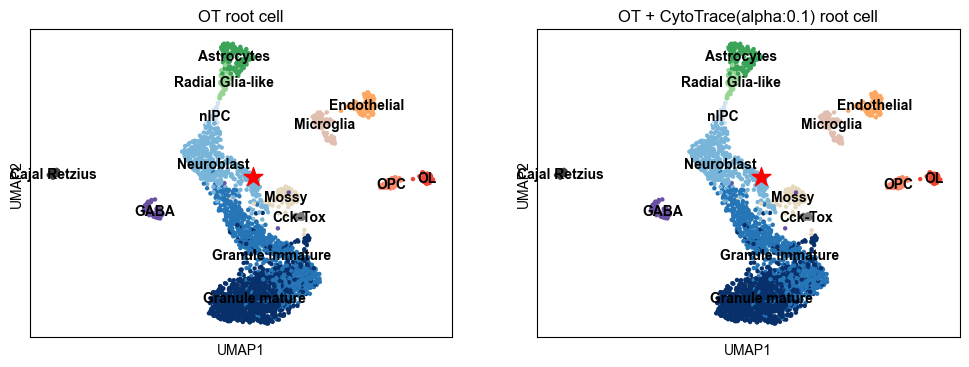

In [33]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'

model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key='clusters', kernel='dpt',
                                  cytotrace=True,  plot=True, basis='umap',
                                 )
pygot.pl.plot_root_cell(adata, color='clusters', basis='umap',figsize=(12,4))

In [34]:
adata

AnnData object with n_obs × n_vars = 2930 × 2000
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'root_loss', 'dpt_pseudotime', 'pseudobin', 'pseudobin_noise', 'idx', 'root_score', 'ct_score', 'ct_pseudotime', 'ct_num_exp_genes', 'ct_root_score', 'int_cluster'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'ct_gene_corr', 'ct_correlates'
    uns: 'clusters_colors', 'log1p', 'pca', 'neighbors', 'diffmap_evals', 'extrema', 'iroot', 'ot_root', 'ct_params', 'ot_ct_root', 'cytotrace_alpha'
    obsm: 'X_umap', 'X_pca', 'X_diffmap'
    varm: 'PCs'
    layers: 'ambiguous', 'spliced', 'unspliced', 'Ms', 'Mu'
    obsp: 'distances', 'connectivities'

In [35]:
cell_type_key = 'clusters'
vis_key = 'umap'

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


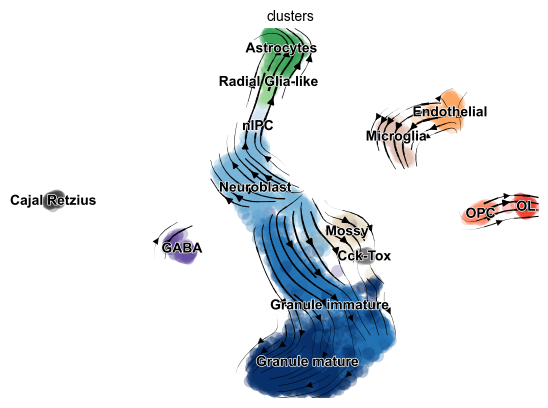

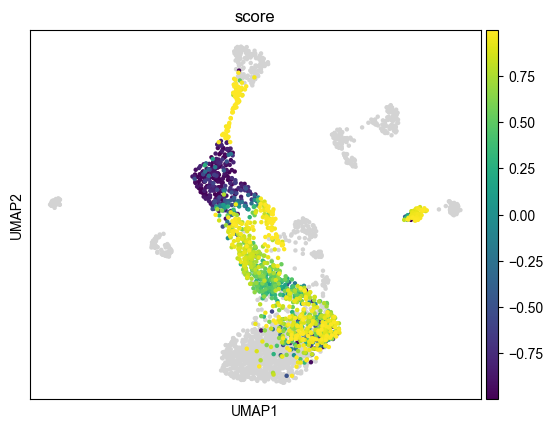

cbc 0.3393545348808651
base 0.29274421299296144


In [36]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata,  basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)

In [37]:
np.save('./results/06_snapshot/dentategyrus/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/dentategyrus/got.npy', adata.layers['velocity'])

  0%|          | 0/2930 [00:00<?, ?cell/s]

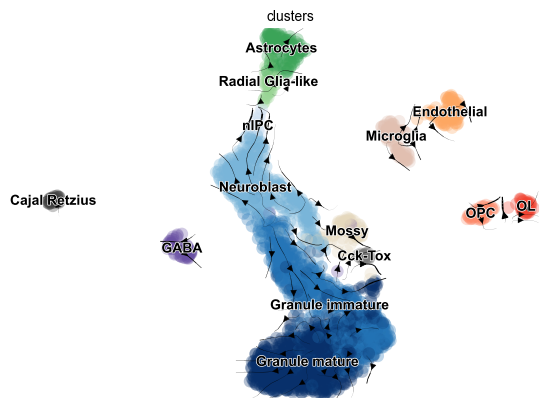

In [38]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key)

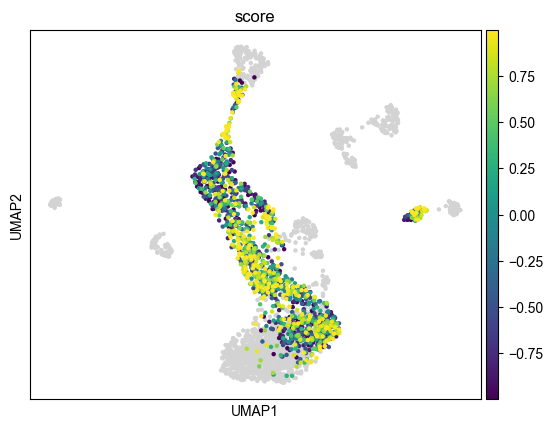

cbc 0.10834587507479428
base -0.011443302193847232


In [39]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/dentategyrus/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [40]:
del adata.uns
sc.write('./results/06_snapshot/dentategyrus/adata_res.h5ad', adata)

## dentategyrus_lamanno

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


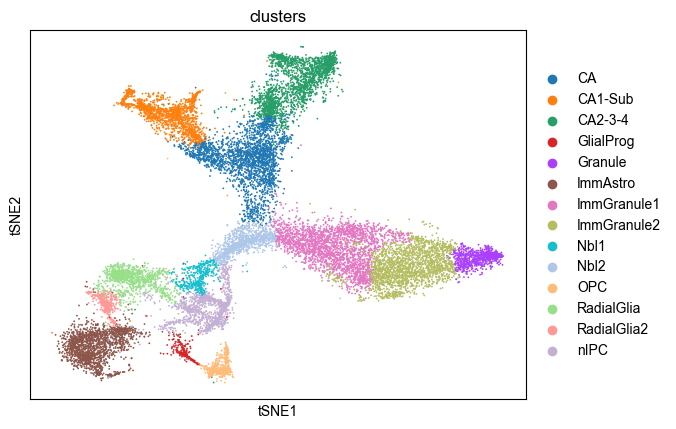

In [41]:
adata = scv.datasets.dentategyrus_lamanno('../pygot_data/snapshot_benchmark_dataset/DentateGyrus/DentateGyrus.loom')
sc.pl.tsne(adata, color='clusters')

[('nIPC', 'GlialProg'), ('Nbl1', 'Nbl2'), ('Nbl2', 'CA'), ('Nbl2', 'ImmGranule1'), ('ImmGranule1', 'ImmGranule2'), ('ImmGranule2', 'Granule'), ('CA', 'CA1-Sub'), ('CA', 'CA2-3-4'), ('RadialGlia', 'RadialGlia2'), ('RadialGlia2', 'ImmAstro'), ('GlialProg', 'OPC')]


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


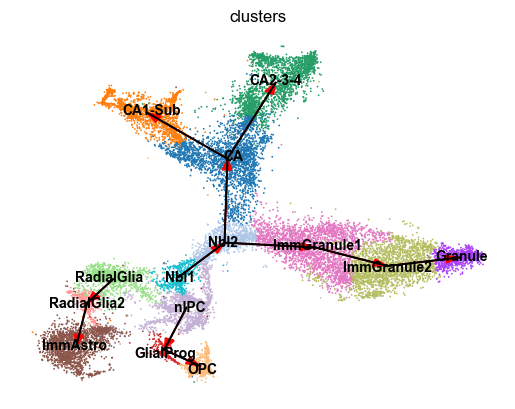

In [42]:
tree = {
    'nIPC':['GlialProg'],
    'Nbl1':['Nbl2'],
    'Nbl2':['CA','ImmGranule1'],
    'ImmGranule1':['ImmGranule2'],
    'ImmGranule2':['Granule'],
    'CA': [ 'CA1-Sub', 'CA2-3-4'],
    'RadialGlia':['RadialGlia2'],
    'RadialGlia2':['ImmAstro'],
    'GlialProg':['OPC'],
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='clusters',  basis='tsne')

In [43]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)


Filtered out 18710 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:24) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 03:26:27	 Using extrema in diffmap space to connect the whole graph
2025-05-07 03:26:29	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [13:27<00:00,  3.72it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 03:40:09	 Determine linear progress or not..
2025-05-07 03:40:09	 Single Branch Progress : False


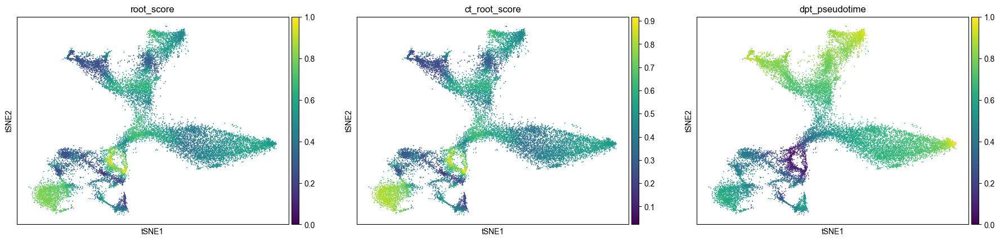

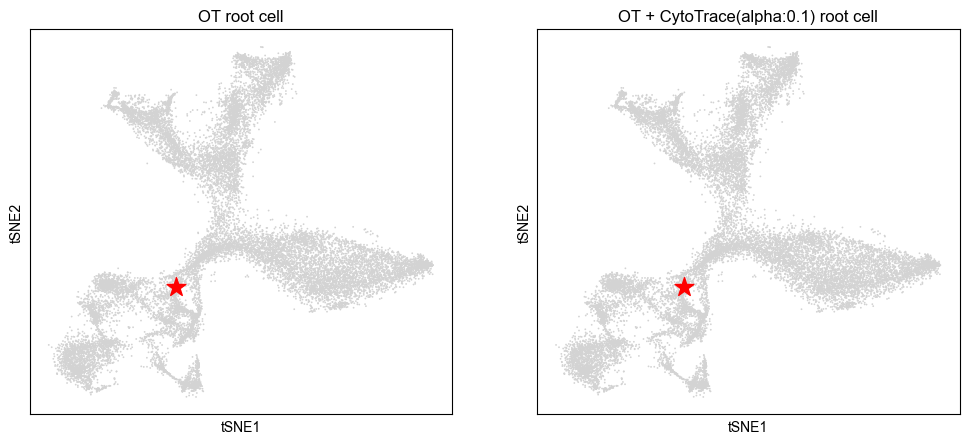

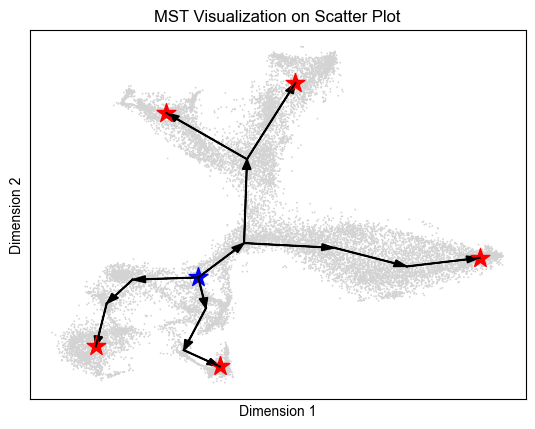

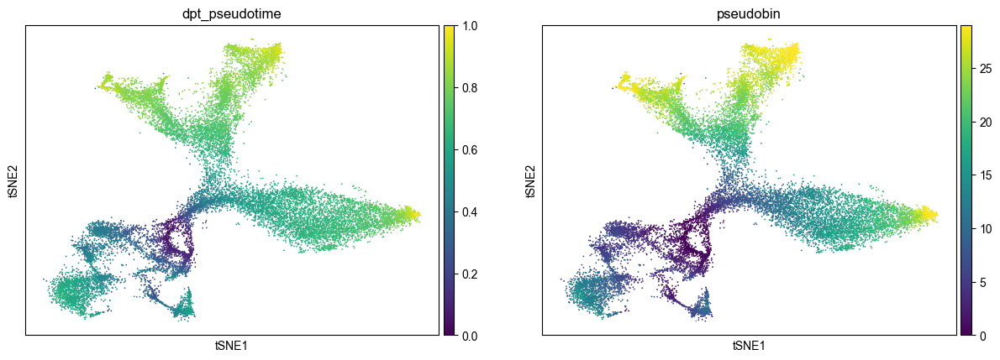

2025-05-07 03:40:10	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 608/608 [00:00<00:00, 1057.47it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 608/608 [00:00<00:00, 1068.02it/s]


calcu shortest path between 2.0 to 3.0


100%|█████████████████████████████████████████████████████████████████████████████| 608/608 [00:00<00:00, 1084.36it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1225.57it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1093.35it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1128.93it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1126.43it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1476.01it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1594.16it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 2021.65it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1824.09it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1771.28it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1598.10it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1385.93it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1300.70it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1241.66it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1151.82it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1149.65it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1152.64it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1129.51it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1119.82it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1110.76it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1118.88it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1107.67it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1081.55it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1076.74it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1093.30it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 607/607 [00:00<00:00, 1083.26it/s]


calcu shortest path between 28.0 to 29.0


loss :1867.6101  best :1867.6101: 100%|█████████████████████████████████████████████| 200/200 [00:56<00:00,  3.51it/s]


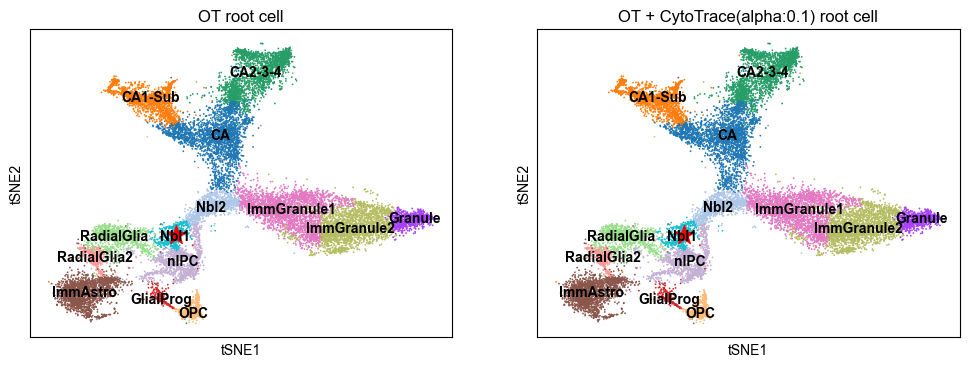

In [44]:
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'

model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key='clusters', kernel='dpt',
                                  cytotrace=True,  plot=True, basis='tsne',
                                 )
pygot.pl.plot_root_cell(adata, color='clusters', basis='tsne',figsize=(12,4))

In [45]:
sc.write('./results/06_snapshot/dentategyrus_lamanno/adata_res.h5ad', adata)

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


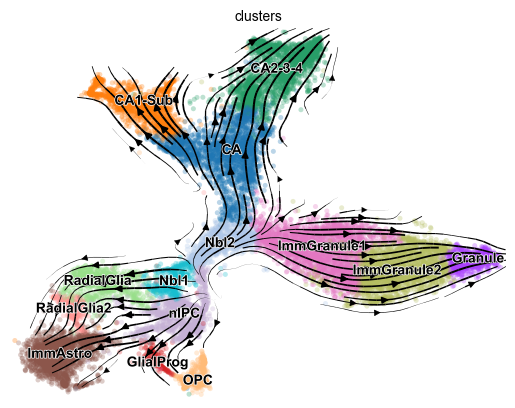

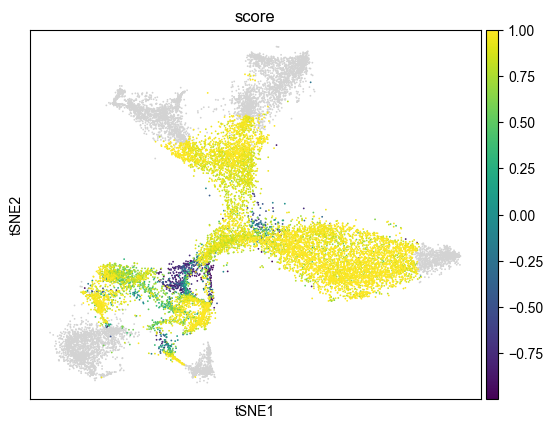

cbc 0.5633359174141664
base 0.7758687351990069


In [47]:
cell_type_key = 'clusters'
vis_key = 'tsne'
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/dentategyrus_lamanno/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/dentategyrus_lamanno/got.npy', adata.layers['velocity'])

  0%|          | 0/18213 [00:00<?, ?cell/s]

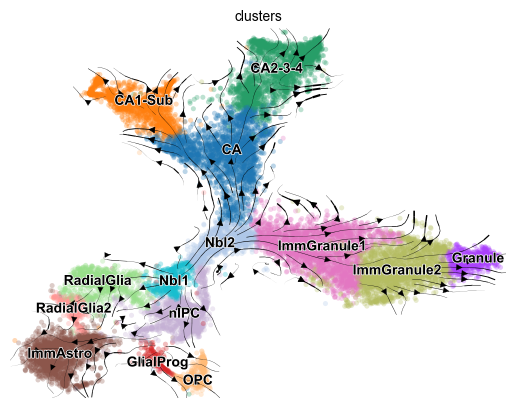

In [48]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

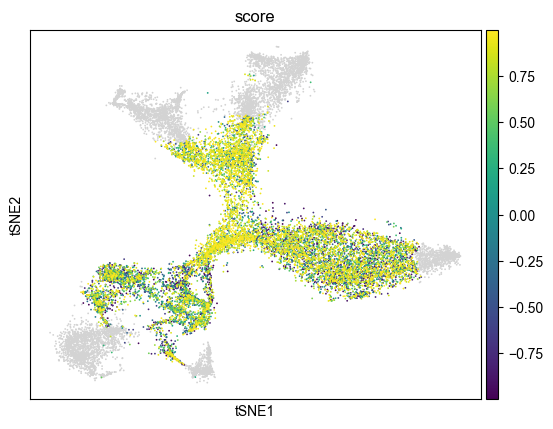

cbc 0.14994471461206824
base 0.2677918783650165


In [49]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/dentategyrus_lamanno/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


## Forebrain

Filtered out 26764 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


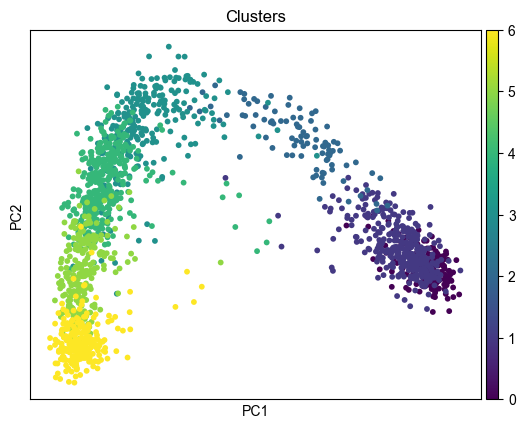

In [55]:
#adata = scv.datasets.forebrain()
adata = sc.read('/disk/share/xuruihong/tmp.h5ad')
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)
sc.pl.pca(adata, color='Clusters')

[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6)]


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


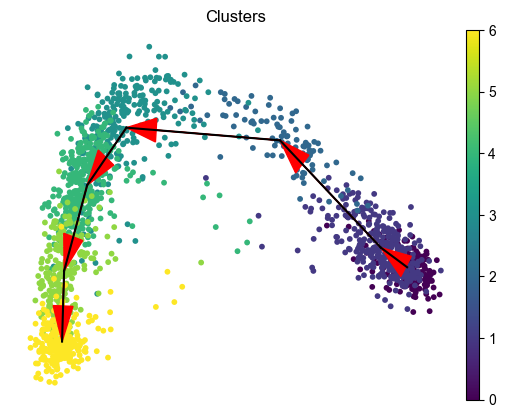

In [56]:
tree = {
    0:[1],
    1:[2],
    2:[3],
    3:[4],    
    4:[5],    
    5:[6],    
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='Clusters',  basis='pca')

2025-05-07 11:33:55	 Using extrema in diffmap space to connect the whole graph
2025-05-07 11:33:56	 Search for the best source cell..
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 1720/1720 [03:09<00:00,  9.07it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 11:37:10	 Determine linear progress or not..
2025-05-07 11:37:10	 Single Branch Progress : True


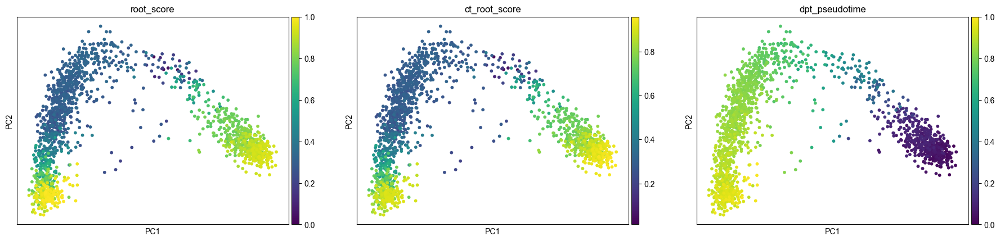

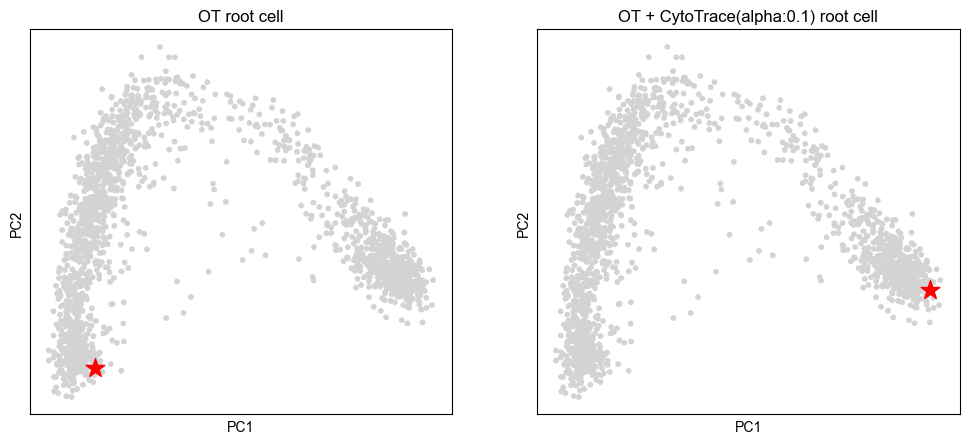

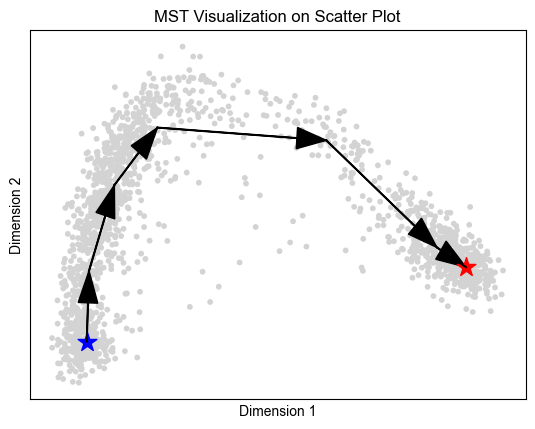

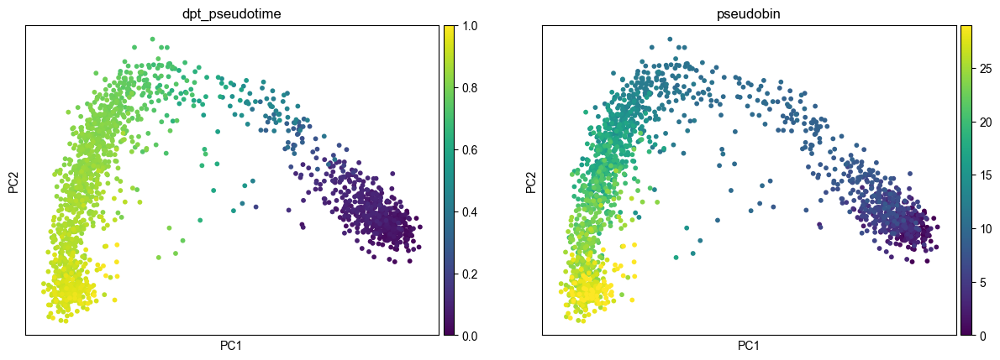

2025-05-07 11:37:12	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4645.83it/s]


calcu shortest path between 1.0 to 2.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4573.94it/s]


calcu shortest path between 2.0 to 3.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4687.28it/s]


calcu shortest path between 3.0 to 4.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4341.31it/s]


calcu shortest path between 4.0 to 5.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4658.64it/s]


calcu shortest path between 5.0 to 6.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4729.10it/s]


calcu shortest path between 6.0 to 7.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4679.79it/s]


calcu shortest path between 7.0 to 8.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4265.12it/s]


calcu shortest path between 8.0 to 9.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4180.90it/s]


calcu shortest path between 9.0 to 10.0


100%|███████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 4674.67it/s]


calcu shortest path between 10.0 to 11.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4547.23it/s]


calcu shortest path between 11.0 to 12.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4649.64it/s]


calcu shortest path between 12.0 to 13.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4637.92it/s]


calcu shortest path between 13.0 to 14.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 2403.20it/s]


calcu shortest path between 14.0 to 15.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4797.82it/s]


calcu shortest path between 15.0 to 16.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4758.00it/s]


calcu shortest path between 16.0 to 17.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4696.68it/s]


calcu shortest path between 17.0 to 18.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 2375.46it/s]


calcu shortest path between 18.0 to 19.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 3435.29it/s]


calcu shortest path between 19.0 to 20.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4226.86it/s]


calcu shortest path between 20.0 to 21.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4245.93it/s]


calcu shortest path between 21.0 to 22.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4541.88it/s]


calcu shortest path between 22.0 to 23.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4531.20it/s]


calcu shortest path between 23.0 to 24.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4713.17it/s]


calcu shortest path between 24.0 to 25.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4711.77it/s]


calcu shortest path between 25.0 to 26.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4575.95it/s]


calcu shortest path between 26.0 to 27.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 4596.90it/s]


calcu shortest path between 27.0 to 28.0


100%|███████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 2306.03it/s]


calcu shortest path between 28.0 to 29.0


loss :1725.4871  best :1725.4871: 100%|█████████████████████████████████████████████| 200/200 [00:52<00:00,  3.79it/s]


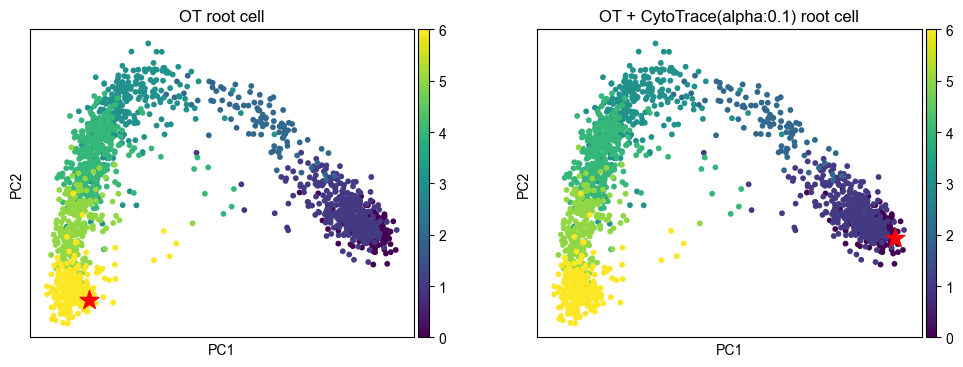

In [57]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'
cell_type_key = 'Clusters'
vis_key = 'pca'
model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key=cell_type_key, kernel='dpt',
                                  cytotrace=True, plot=True, basis=vis_key,
                                  )
pygot.pl.plot_root_cell(adata, color=cell_type_key, basis=vis_key,figsize=(12,4))

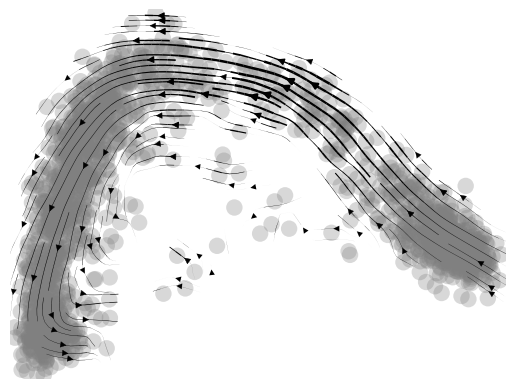

cbc 0.23247826
base 0.60796916


In [58]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
#sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/forebrain/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/forebrain/got.npy', adata.layers['velocity'])

  0%|          | 0/1720 [00:00<?, ?cell/s]

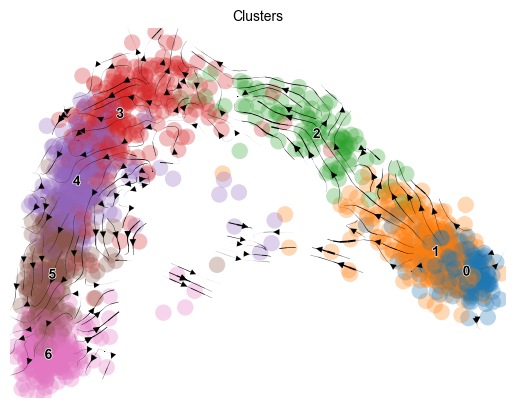

In [59]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

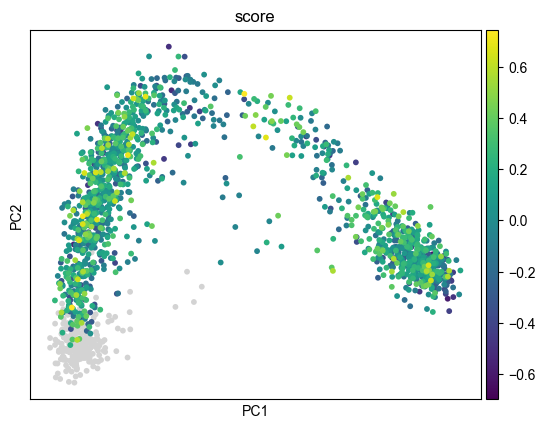

cbc -0.015266441
base 0.041836232


In [60]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/forebrain/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [61]:
del adata.uns
sc.write('./results/06_snapshot/forebrain/adata_res.h5ad', adata)

## gastrulation_erythroid

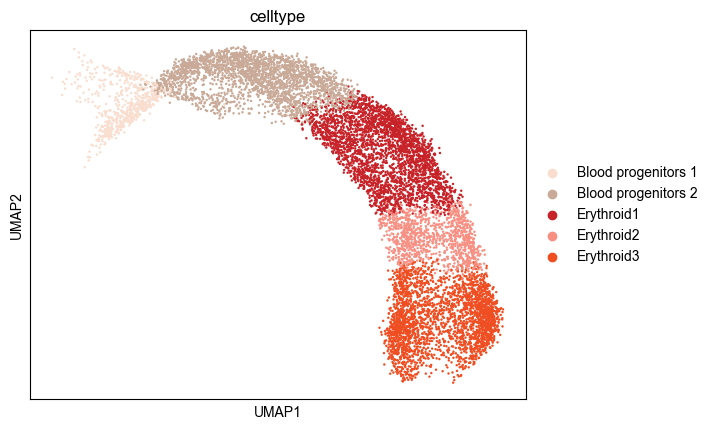

In [63]:
#adata = scv.datasets.gastrulation_erythroid()
adata = sc.read('../pygot_data/snapshot_benchmark_dataset/Gastrulation/erythroid_lineage.h5ad')
sc.pl.umap(adata, color='celltype')

[('Blood progenitors 1', 'Blood progenitors 2'), ('Blood progenitors 2', 'Erythroid1'), ('Erythroid1', 'Erythroid2'), ('Erythroid2', 'Erythroid3')]


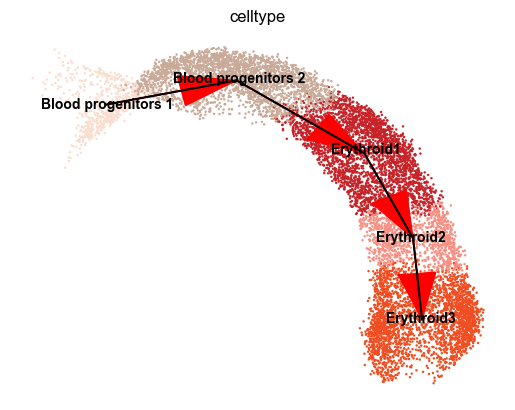

In [64]:
tree = {
    'Blood progenitors 1':['Blood progenitors 2'],
    'Blood progenitors 2':['Erythroid1'],
    'Erythroid1':['Erythroid2'],
    'Erythroid2':['Erythroid3'],    
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='celltype',  basis='umap')

In [65]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
sc.tl.pca(adata, n_comps=30)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 47456 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 11:53:22	 Using extrema in diffmap space to connect the whole graph
2025-05-07 11:53:23	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [27:26<00:00,  1.82it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 12:21:04	 Determine linear progress or not..
2025-05-07 12:21:04	 Single Branch Progress : True


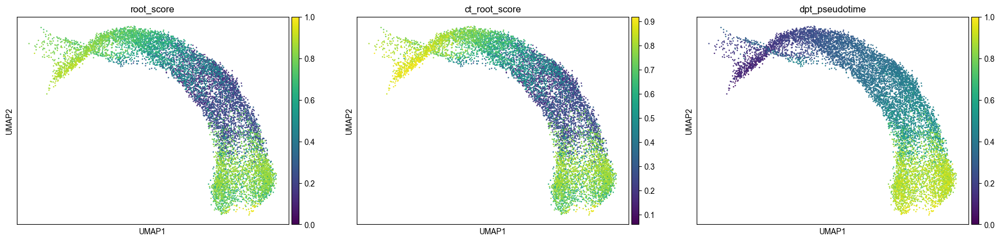

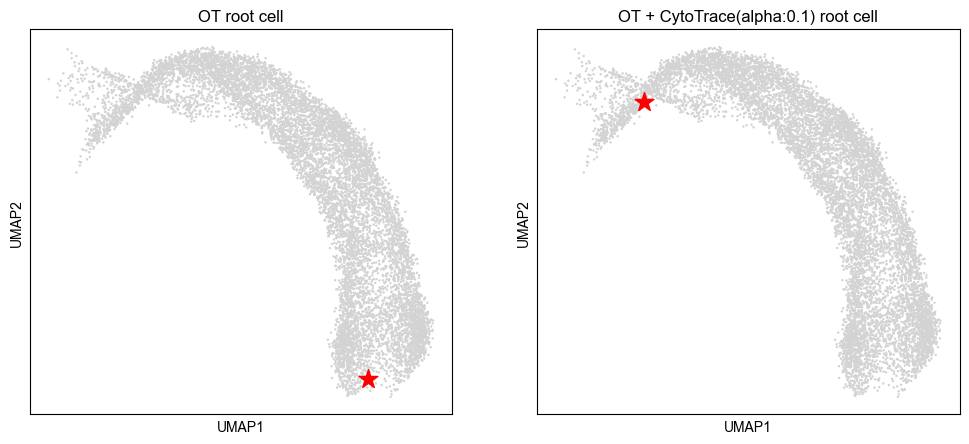

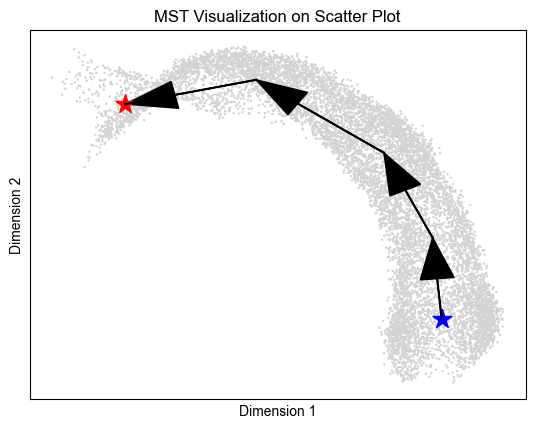

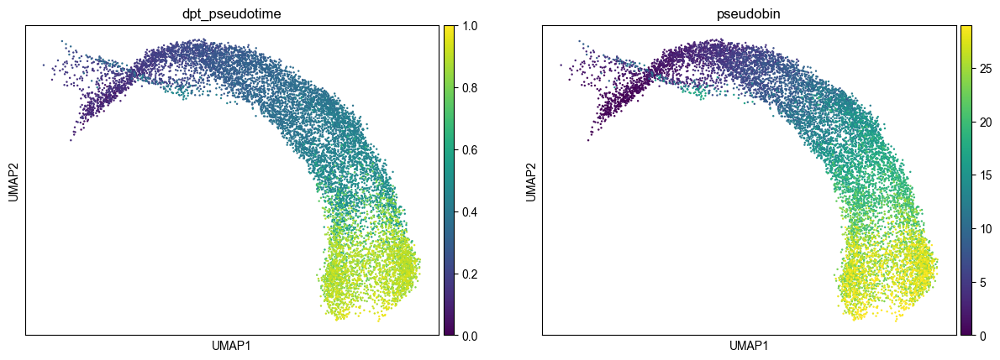

2025-05-07 12:21:05	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 328/328 [00:00<00:00, 1595.40it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 328/328 [00:00<00:00, 1803.41it/s]


calcu shortest path between 2.0 to 3.0


100%|█████████████████████████████████████████████████████████████████████████████| 328/328 [00:00<00:00, 1784.00it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 328/328 [00:00<00:00, 1692.77it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 328/328 [00:00<00:00, 1781.61it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1841.58it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1885.57it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1852.45it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1884.98it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1900.94it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1876.01it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1952.99it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1848.15it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1890.09it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1783.53it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1826.11it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1815.28it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1819.45it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1789.08it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1827.48it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1845.11it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1804.64it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1616.62it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1866.98it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1513.73it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1892.84it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1873.87it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 327/327 [00:00<00:00, 1817.74it/s]


calcu shortest path between 28.0 to 29.0


loss :1005.0638  best :1005.0638: 100%|█████████████████████████████████████████████| 200/200 [01:18<00:00,  2.55it/s]


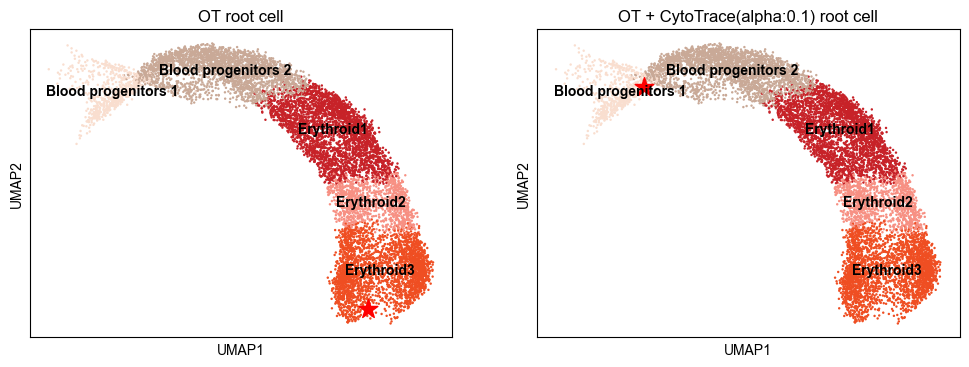

In [66]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'
cell_type_key = 'celltype'
vis_key = 'umap'
model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key=cell_type_key, kernel='dpt', 
                                  cytotrace=True, plot=True, basis=vis_key,
                                  )
pygot.pl.plot_root_cell(adata, color=cell_type_key, basis=vis_key,figsize=(12,4))

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


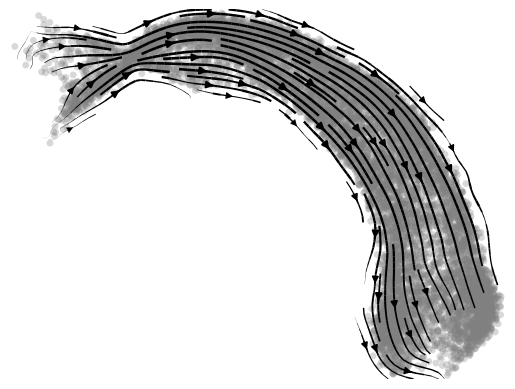

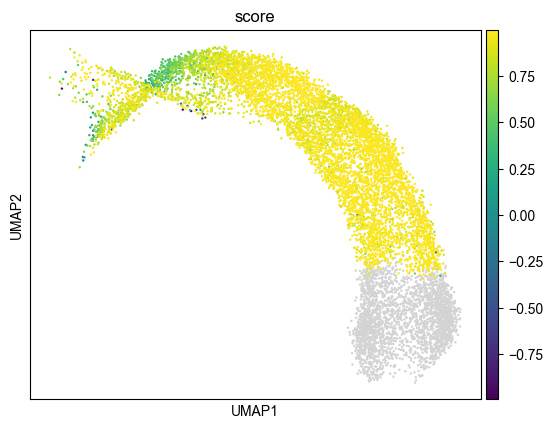

cbc 0.8462419913697496
base 0.9015627576344304


In [67]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/gatrulation_erythroid/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/gatrulation_erythroid/got.npy', adata.layers['velocity'])

  0%|          | 0/9815 [00:00<?, ?cell/s]

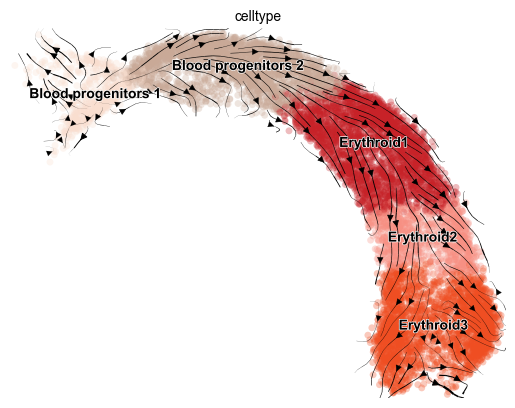

In [68]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

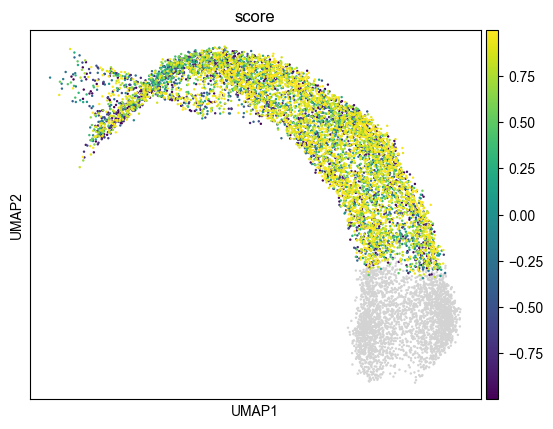

cbc 0.21407812147828992
base 0.279296222106706


In [69]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/gatrulation_erythroid/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [70]:
del adata.uns
sc.write('./results/06_snapshot/gatrulation_erythroid/adata_res.h5ad', adata)

## endocrinogenesis_day15.5

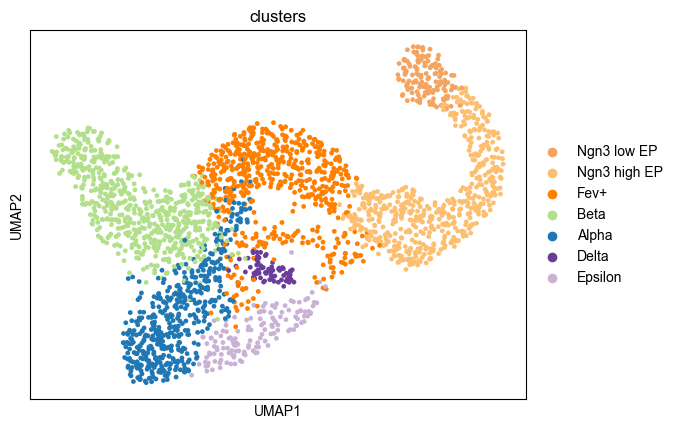

In [71]:
adata = sc.read('../pygot_data/06_snapshot/endocrinogenesis_day15.5.h5ad')
sc.pl.umap(adata, color='clusters')

[('Ngn3 low EP', 'Ngn3 high EP'), ('Ngn3 high EP', 'Fev+'), ('Fev+', 'Alpha'), ('Fev+', 'Beta'), ('Fev+', 'Delta'), ('Fev+', 'Epsilon')]


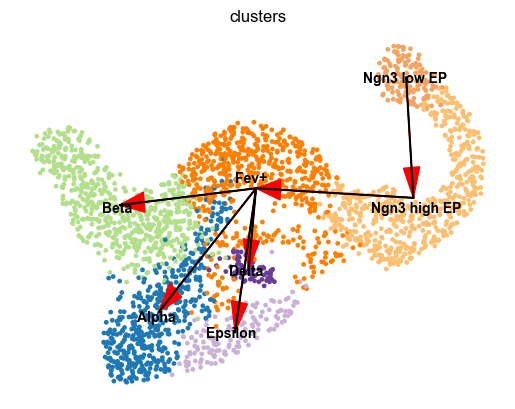

In [72]:
tree = {
    
    'Ngn3 low EP':['Ngn3 high EP'],
    'Ngn3 high EP':['Fev+'],
    'Fev+':['Alpha', 'Beta', 'Delta', 'Epsilon'],
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='clusters',  basis='umap')

In [73]:
if 'neighbors' in adata.uns.keys():
    del adata.uns['neighbors']
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 22024 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 12:26:07	 Using extrema in diffmap space to connect the whole graph
2025-05-07 12:26:07	 Search for the best source cell..
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 2531/2531 [11:29<00:00,  3.67it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 12:37:47	 Determine linear progress or not..
2025-05-07 12:37:47	 Single Branch Progress : False


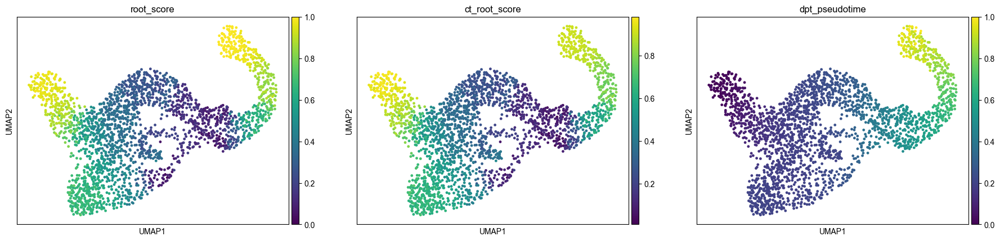

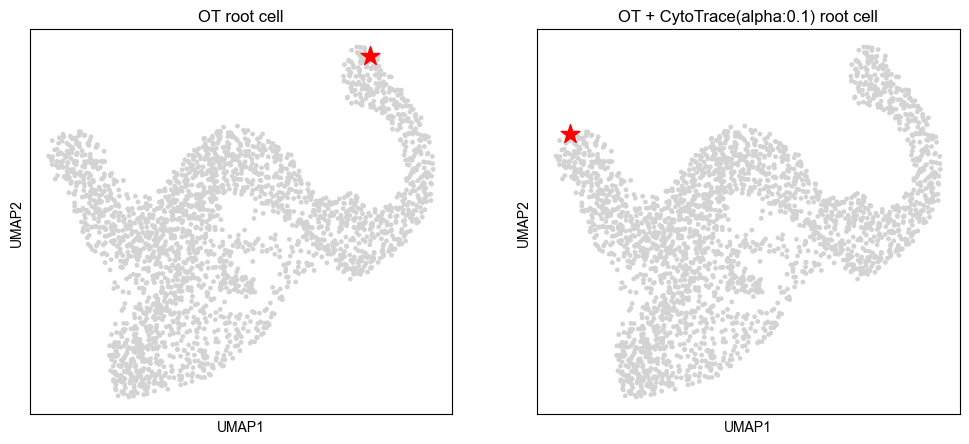

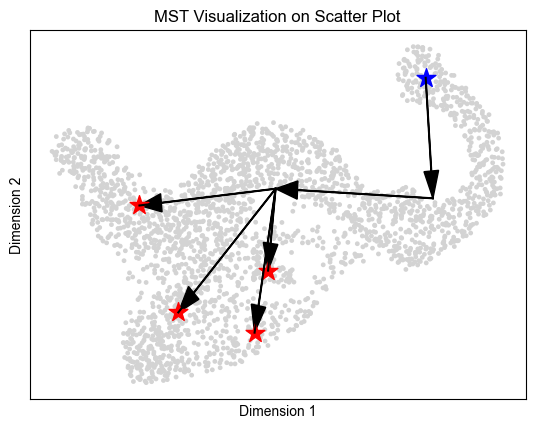

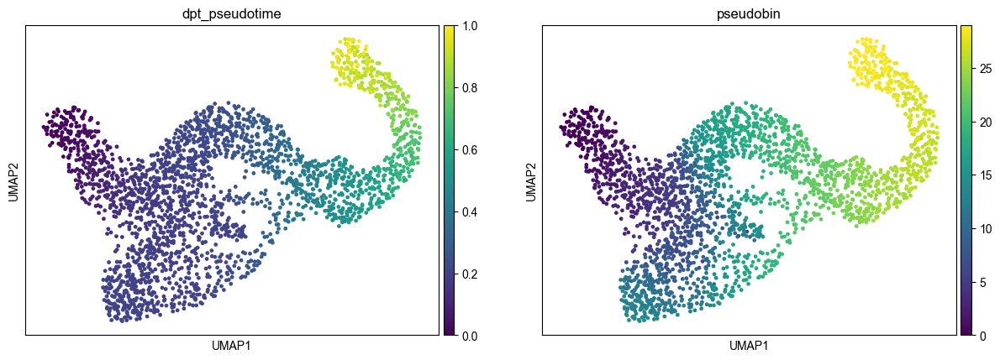

2025-05-07 12:37:48	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4126.10it/s]


calcu shortest path between 1.0 to 2.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4013.73it/s]


calcu shortest path between 2.0 to 3.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4084.92it/s]


calcu shortest path between 3.0 to 4.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4067.35it/s]


calcu shortest path between 4.0 to 5.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4137.69it/s]


calcu shortest path between 5.0 to 6.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4070.88it/s]


calcu shortest path between 6.0 to 7.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 2218.39it/s]


calcu shortest path between 7.0 to 8.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 3512.75it/s]


calcu shortest path between 8.0 to 9.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4050.07it/s]


calcu shortest path between 9.0 to 10.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4101.70it/s]


calcu shortest path between 10.0 to 11.0


100%|███████████████████████████████████████████████████████████████████████████████| 85/85 [00:00<00:00, 4121.19it/s]


calcu shortest path between 11.0 to 12.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4072.28it/s]


calcu shortest path between 12.0 to 13.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3898.44it/s]


calcu shortest path between 13.0 to 14.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4145.20it/s]

calcu shortest path between 14.0 to 15.0



100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3805.63it/s]

calcu shortest path between 15.0 to 16.0



100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3848.62it/s]


calcu shortest path between 16.0 to 17.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3874.18it/s]


calcu shortest path between 17.0 to 18.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3884.04it/s]


calcu shortest path between 18.0 to 19.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3825.63it/s]


calcu shortest path between 19.0 to 20.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3860.13it/s]


calcu shortest path between 20.0 to 21.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3889.15it/s]


calcu shortest path between 21.0 to 22.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3804.56it/s]


calcu shortest path between 22.0 to 23.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 3874.18it/s]


calcu shortest path between 23.0 to 24.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4164.41it/s]


calcu shortest path between 24.0 to 25.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4090.25it/s]


calcu shortest path between 25.0 to 26.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4064.76it/s]


calcu shortest path between 26.0 to 27.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4071.90it/s]


calcu shortest path between 27.0 to 28.0


100%|███████████████████████████████████████████████████████████████████████████████| 84/84 [00:00<00:00, 4065.09it/s]


calcu shortest path between 28.0 to 29.0


loss :1.2709 best :1.2709: 100%|████████████████████████████████████████████████████| 500/500 [06:00<00:00,  1.39it/s]


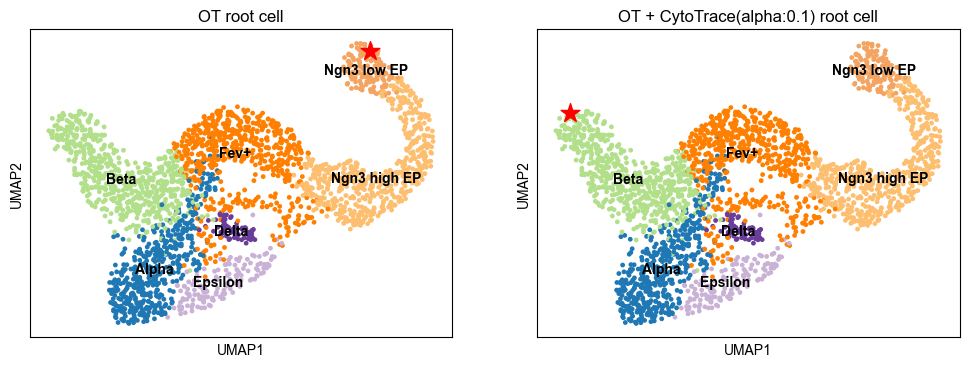

In [74]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'
cell_type_key = 'clusters'
vis_key = 'umap'
model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key=cell_type_key, kernel='dpt',
                                  cytotrace=True,plot=True, basis=vis_key,
                                  x_centric=False, v_centric_iter_n=500, linear=True)
pygot.pl.plot_root_cell(adata, color=cell_type_key, basis=vis_key,figsize=(12,4))

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


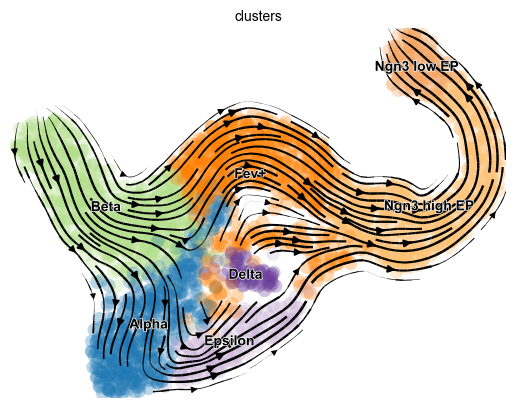

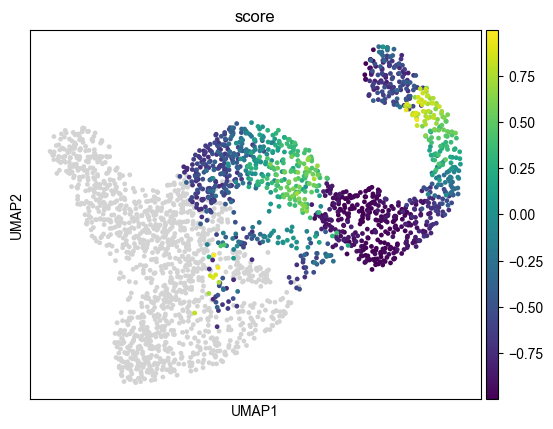

cbc -0.5850569216510647
base -0.37931456797364416


In [75]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/endocrinogenesis_day15.5/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/endocrinogenesis_day15.5/got.npy', adata.layers['velocity'])

  0%|          | 0/2531 [00:00<?, ?cell/s]

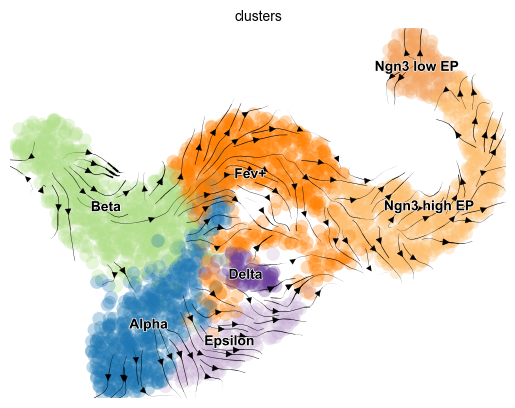

In [76]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

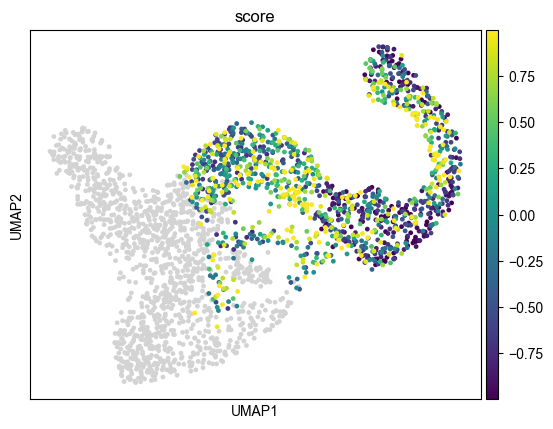

cbc -0.28457806
base -0.05549613986553496


In [77]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/endocrinogenesis_day15.5/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [78]:
del adata.uns
sc.write('./results/06_snapshot/endocrinogenesis_day15.5/adata_res.h5ad', adata)

## neuron_splicing_lite

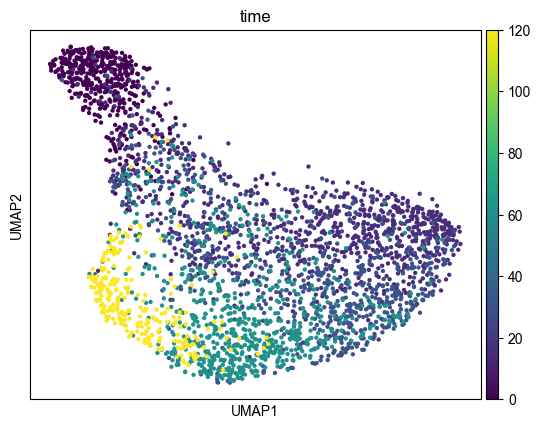

In [79]:
adata = sc.read('../pygot_data/06_snapshot/neuron_splicing_lite.h5ad')
sc.pl.umap(adata, color='time')

[('0', '15'), ('15', '30'), ('30', '60'), ('60', '120')]


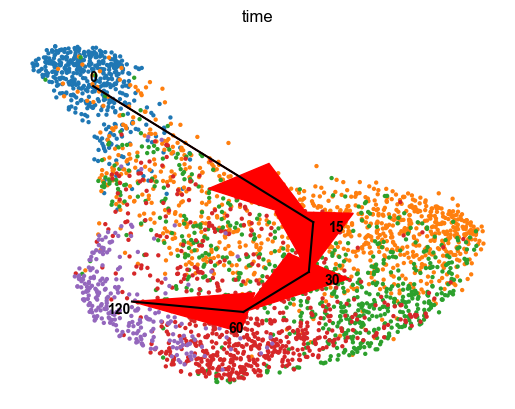

In [80]:
tree = {
    '0':['15'],
    '15':['30'],
    '30':['60'],
    '60':['120']
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
adata.obs['time'] = adata.obs['time'].astype(str)

plot_mst(adata, tree, cell_type_key='time',  basis='umap')
#adata.obs['time'] = adata.obs['time'].astype(int)

In [81]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 38268 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 12:44:13	 Using extrema in diffmap space to connect the whole graph
2025-05-07 12:44:14	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [14:13<00:00,  3.51it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 12:58:41	 Determine linear progress or not..
2025-05-07 12:58:41	 Single Branch Progress : True


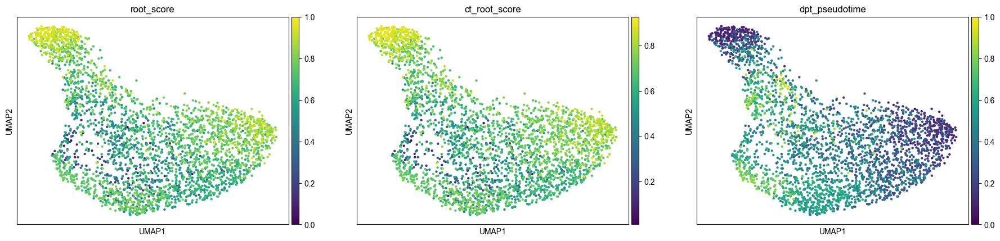

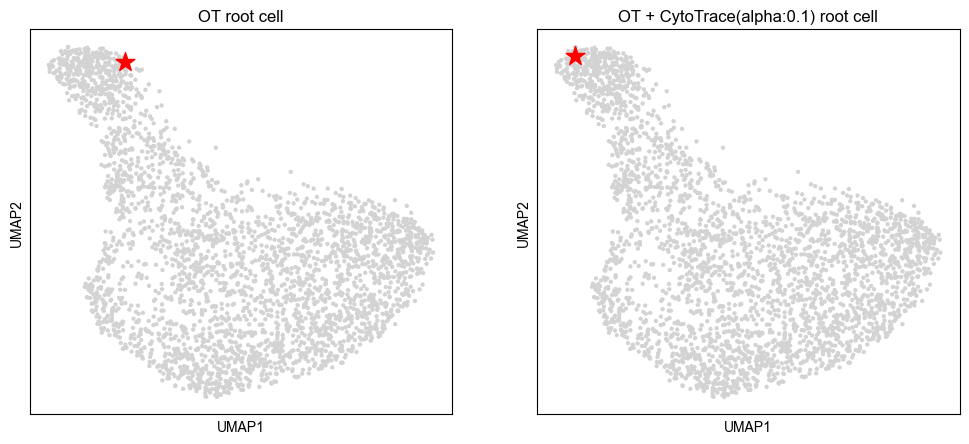

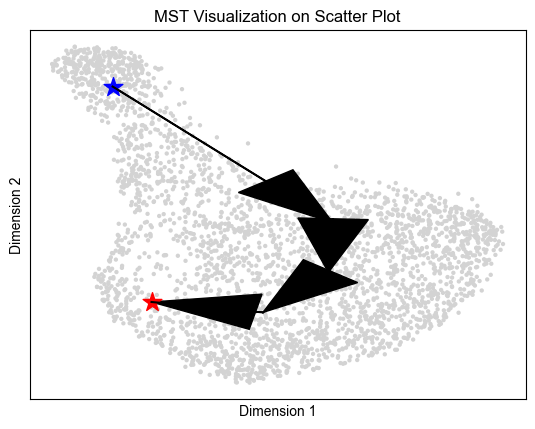

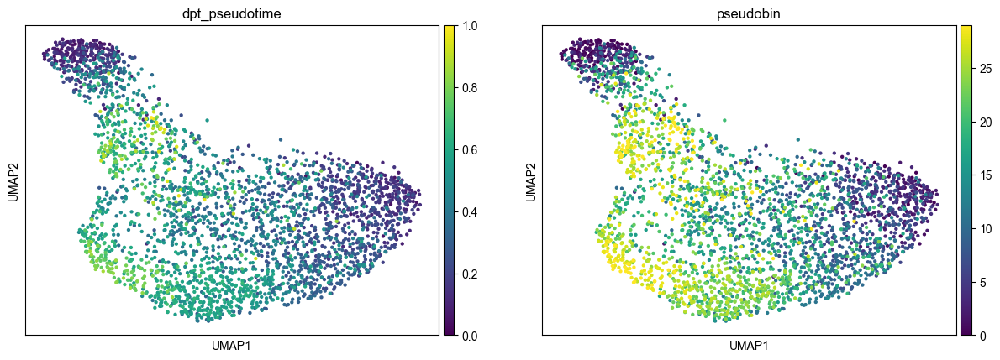

2025-05-07 12:58:43	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 3585.77it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 3590.89it/s]


calcu shortest path between 2.0 to 3.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 3697.67it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 3661.56it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 2235.54it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 3717.97it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3712.90it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3707.98it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 2217.49it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3658.67it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3634.86it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3605.42it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3548.13it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3617.28it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3607.46it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 2070.50it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3621.59it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3622.55it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3569.50it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3539.99it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3594.76it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3548.95it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3480.84it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3453.91it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3464.74it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 3692.36it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 2546.13it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 102/102 [00:00<00:00, 2874.16it/s]


calcu shortest path between 28.0 to 29.0


loss :0.9502 best :0.9502: 100%|████████████████████████████████████████████████████| 500/500 [05:45<00:00,  1.45it/s]


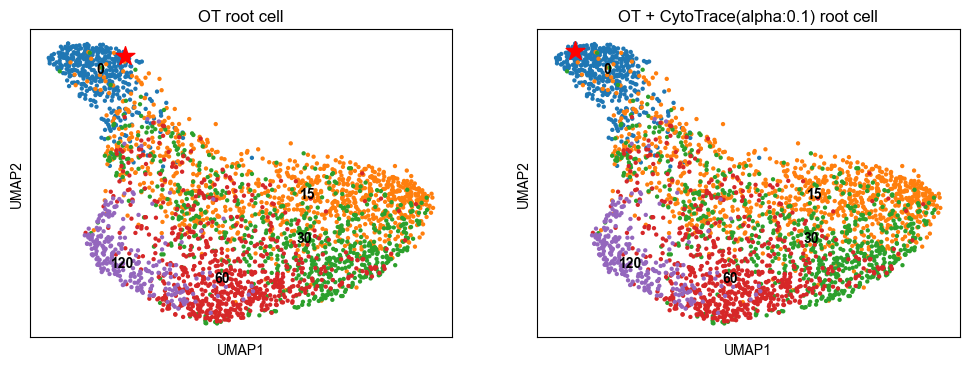

In [82]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'
cell_type_key = 'time'
vis_key = 'umap'
model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key=cell_type_key, kernel='dpt',
                                  cytotrace=True, plot=True, basis=vis_key,
                                  x_centric=False, v_centric_iter_n=500, linear=True)
pygot.pl.plot_root_cell(adata, color=cell_type_key, basis=vis_key,figsize=(12,4))

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


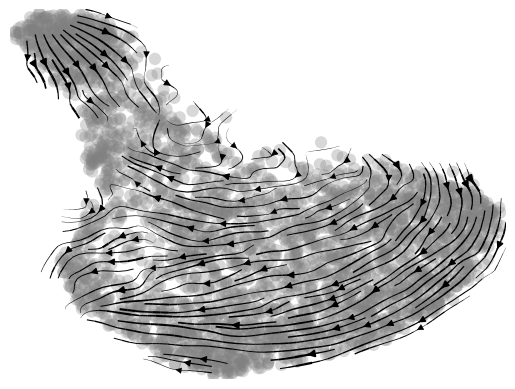

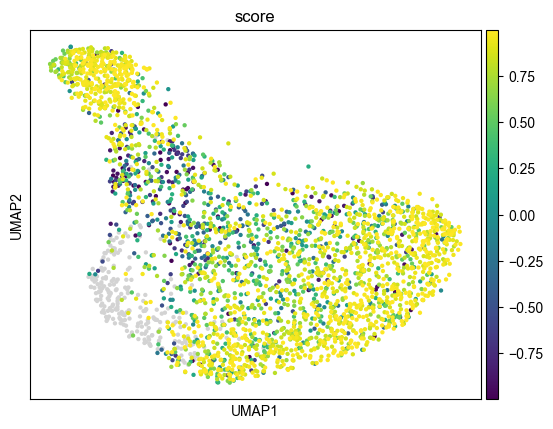

cbc 0.4271855874982327
base 0.5856927012900061


In [83]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/neuron_splicing_lite/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/neuron_splicing_lite/got.npy', adata.layers['velocity'])

  0%|          | 0/3066 [00:00<?, ?cell/s]

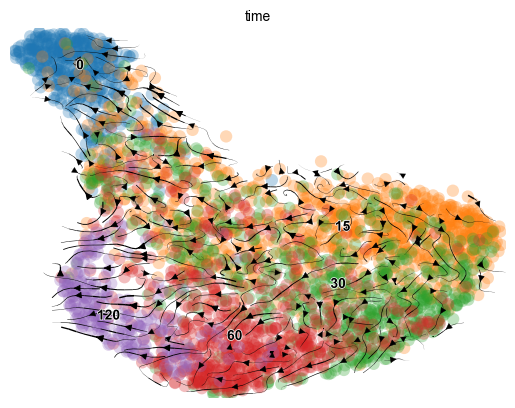

In [84]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

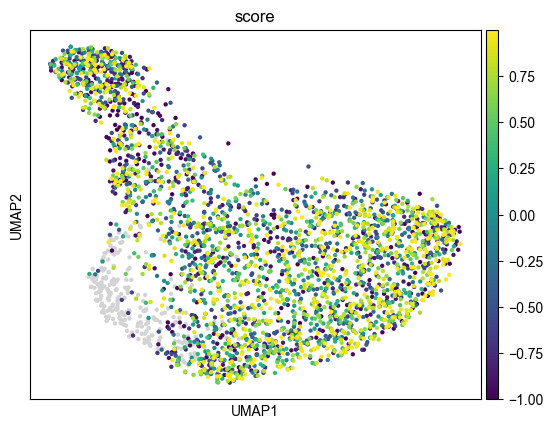

cbc 0.066103205
base 0.04750604629565711


In [85]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/neuron_splicing_lite/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [86]:
del adata.uns
sc.write('./results/06_snapshot/neuron_splicing_lite/adata_res.h5ad', adata)

## oligo_lite

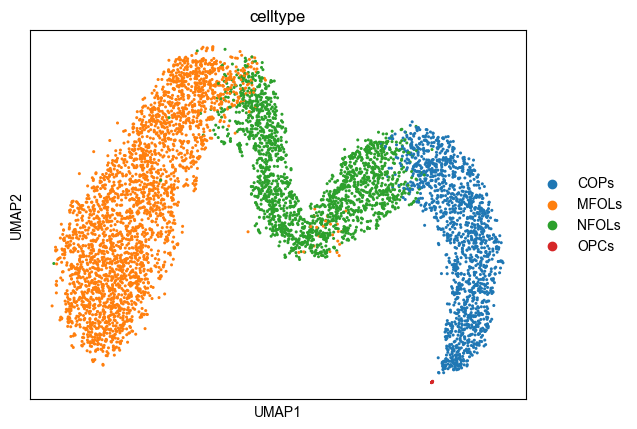

In [87]:
adata = sc.read('../pygot_data/06_snapshot/oligo_lite.h5ad')
sc.pl.umap(adata, color='celltype')

[('COPs', 'NFOLs'), ('NFOLs', 'MFOLs')]


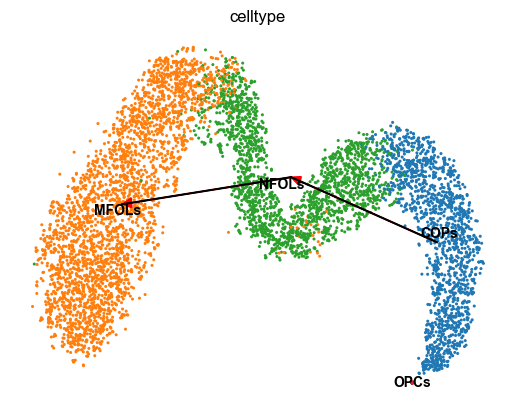

In [88]:
tree = {    
    #'OPCs':['COPs'],
    'COPs':['NFOLs'],
    'NFOLs':['MFOLs'],
}
edges = []
for key in tree:
    for target in tree[key]:
        edges.append((key, target))
print(edges)
plot_mst(adata, tree, cell_type_key='celltype',  basis='umap')

In [89]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
sc.tl.pca(adata, n_comps=30)

Filtered out 22484 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


2025-05-07 13:05:05	 Using extrema in diffmap space to connect the whole graph
2025-05-07 13:05:05	 Search for the best source cell..
Down sampling
Convert into connected graph


100%|█████████████████████████████████████████████████████████████████████████████| 3000/3000 [16:06<00:00,  3.10it/s]


optimal transport root cell write in adata.uns['ot_root']
optimal transport + cytotrace root cell write in adata.uns['ot_ct_root']
2025-05-07 13:21:26	 Determine linear progress or not..
2025-05-07 13:21:26	 Single Branch Progress : True


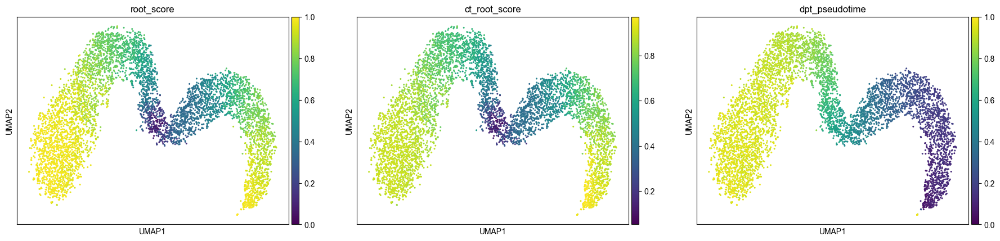

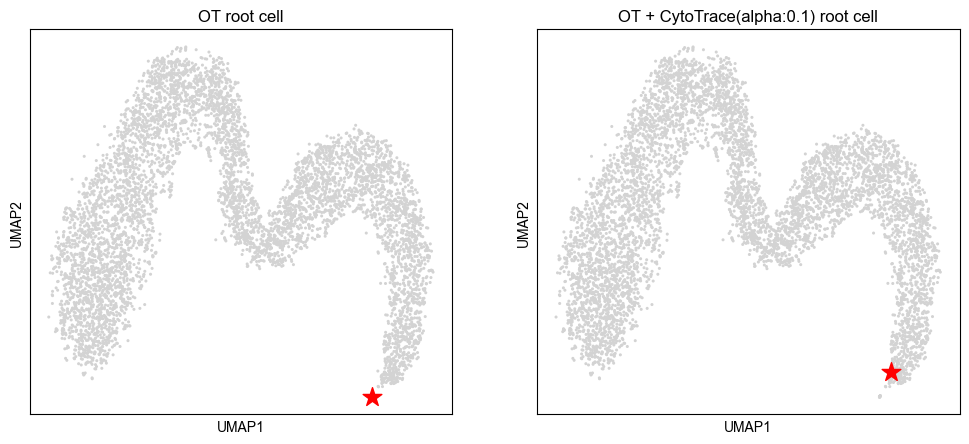

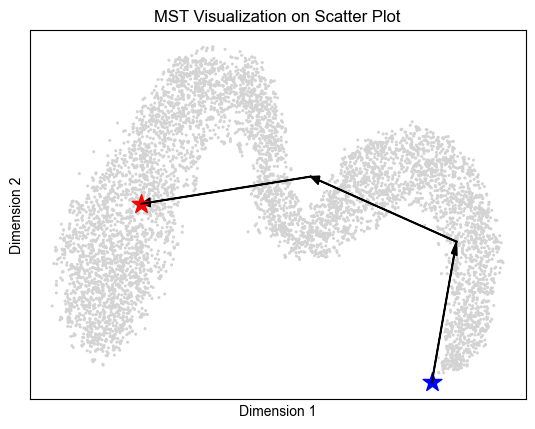

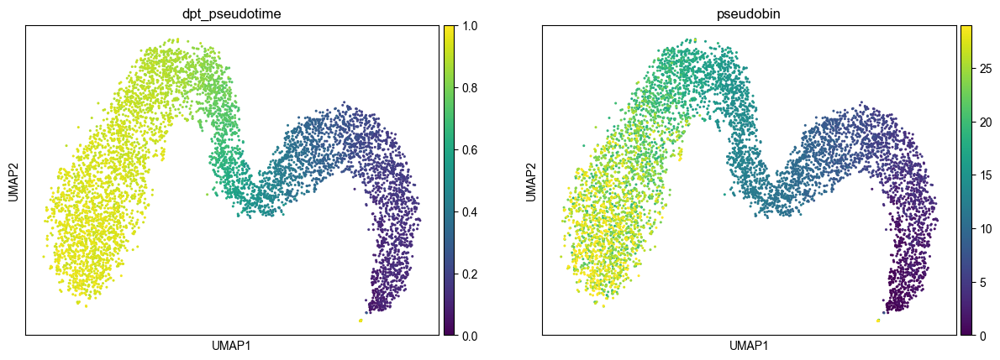

2025-05-07 13:21:28	 Start to fit velocity model
loading saved shortest path profile
[Errno 2] No such file or directory: '_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2530.30it/s]


calcu shortest path between 1.0 to 2.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 1854.67it/s]


calcu shortest path between 2.0 to 3.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2538.68it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2537.10it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2530.01it/s]


calcu shortest path between 5.0 to 6.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2496.38it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 1867.23it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2525.19it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2518.46it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 1919.63it/s]


calcu shortest path between 10.0 to 11.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2548.77it/s]


calcu shortest path between 11.0 to 12.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2569.61it/s]


calcu shortest path between 12.0 to 13.0


100%|█████████████████████████████████████████████████████████████████████████████| 209/209 [00:00<00:00, 2561.40it/s]


calcu shortest path between 13.0 to 14.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2540.56it/s]


calcu shortest path between 14.0 to 15.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2552.77it/s]


calcu shortest path between 15.0 to 16.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2622.30it/s]


calcu shortest path between 16.0 to 17.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2637.50it/s]


calcu shortest path between 17.0 to 18.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 1620.89it/s]


calcu shortest path between 18.0 to 19.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2563.63it/s]


calcu shortest path between 19.0 to 20.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2568.81it/s]


calcu shortest path between 20.0 to 21.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2570.33it/s]


calcu shortest path between 21.0 to 22.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2564.00it/s]


calcu shortest path between 22.0 to 23.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2559.60it/s]


calcu shortest path between 23.0 to 24.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2573.25it/s]


calcu shortest path between 24.0 to 25.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2552.88it/s]


calcu shortest path between 25.0 to 26.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2547.51it/s]


calcu shortest path between 26.0 to 27.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2469.37it/s]


calcu shortest path between 27.0 to 28.0


100%|█████████████████████████████████████████████████████████████████████████████| 208/208 [00:00<00:00, 2546.58it/s]


calcu shortest path between 28.0 to 29.0


loss :0.6573 best :0.6559: 100%|████████████████████████████████████████████████████| 500/500 [06:10<00:00,  1.35it/s]


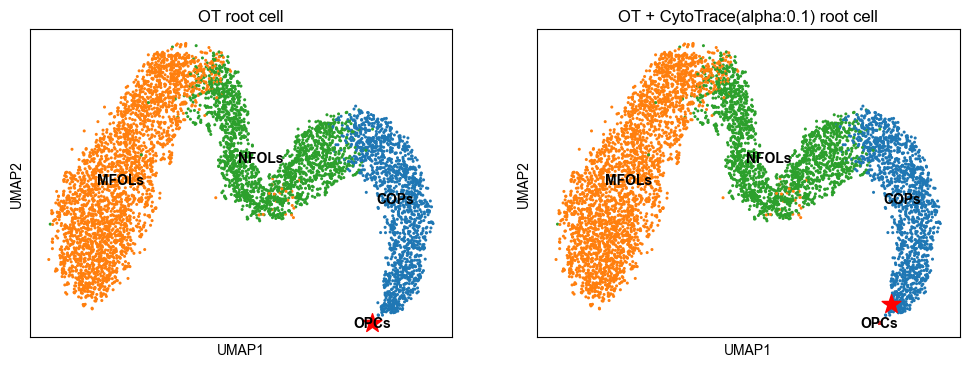

In [90]:
import warnings
warnings.filterwarnings('ignore')
embedding_key = 'X_pca'
velocity_key = 'velocity_pca'
cell_type_key = 'celltype'
vis_key = 'umap'
model, _ = pygot.tl.traj.fit_velocity_model_without_time(adata, embedding_key, cell_type_key=cell_type_key, kernel='dpt',
                                  cytotrace=True, plot=True, basis=vis_key,
                                  x_centric=False, v_centric_iter_n=500, linear=True)
pygot.pl.plot_root_cell(adata, color=cell_type_key, basis=vis_key,figsize=(12,4))

Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


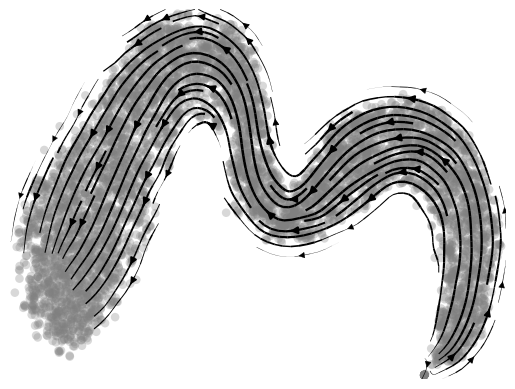

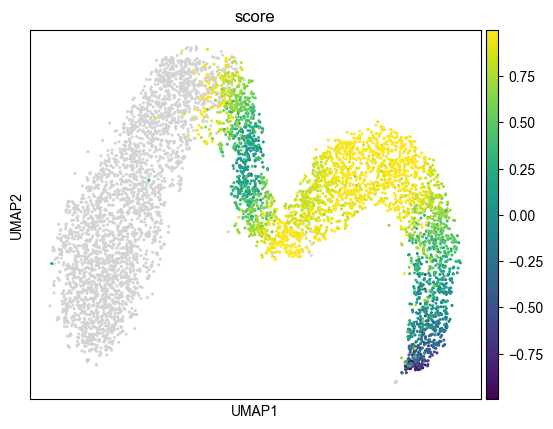

cbc 0.6121509144489521
base 0.5817495918070985


In [91]:
adata.layers['velocity'] = pygot.tl.traj.velocity(adata, model)
pygot.tl.traj.velocity_graph(adata, embedding_key=embedding_key, velocity_key=velocity_key,)
scv.pl.velocity_embedding_stream(adata, basis=vis_key)
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/oligo_lite/got_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])
np.save('./results/06_snapshot/oligo_lite/got.npy', adata.layers['velocity'])

  0%|          | 0/6253 [00:00<?, ?cell/s]

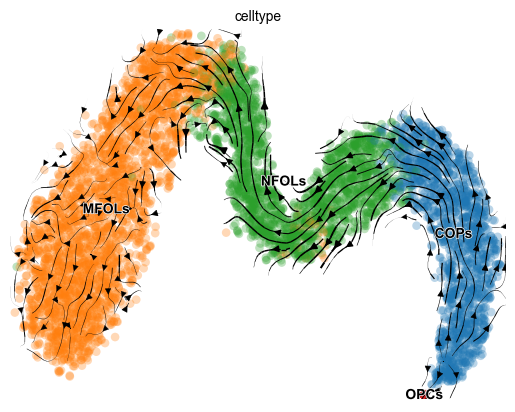

In [92]:
import cellrank as ck
pk = ck.kernels.PseudotimeKernel(adata, time_key='dpt_pseudotime')
pk.compute_transition_matrix()
pk.plot_projection(color=cell_type_key, basis=vis_key, recompute=True)

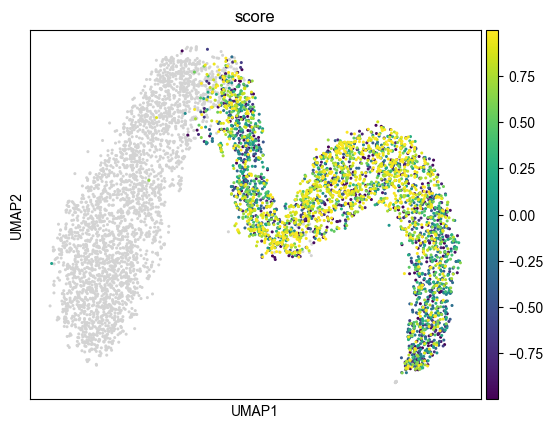

cbc 0.2494317062685394
base 0.19691818249444215


In [93]:
adata.obsm['velocity_'+vis_key] = adata.obsm['T_fwd_'+vis_key]
_, cbc = cross_boundary_correctness(adata, cell_type_key, 'velocity_'+vis_key, edges, False, 'X_'+vis_key)

for key in tree.keys():
    score_cell_by_tree(adata, cell_type_key, key, tree, vis_key)
sc.pl.embedding(adata, color='score', basis=vis_key)
score_mean=np.nanmean(adata.obs["score"])
print('cbc', cbc)
print('base',score_mean)
np.save('./results/06_snapshot/oligo_lite/cellrank_' + vis_key + '.npy', adata.obsm['velocity_'+vis_key])


In [94]:
del adata.uns
sc.write('./results/06_snapshot/oligo_lite/adata_res.h5ad', adata)

# Plot results

In [97]:

adata1 = sc.read('./results/06_snapshot/pancreas/adata_res.h5ad')
adata1.uns = scv.datasets.pancreas().uns

adata2 = sc.read('./results/06_snapshot/bonemarrow/adata_res.h5ad')
adata2.uns = scv.datasets.bonemarrow().uns

adata3 = sc.read('./results/06_snapshot/dentategyrus/adata_res.h5ad')
adata3.uns = scv.datasets.dentategyrus().uns

adata4 = sc.read('./results/06_snapshot/dentategyrus_lamanno/adata_res.h5ad')
adata4.uns = scv.datasets.dentategyrus_lamanno('../pygot_data/snapshot_benchmark_dataset/DentateGyrus/DentateGyrus.loom').uns

adata5 = sc.read('./results/06_snapshot/forebrain/adata_res.h5ad')
#adata5.uns = scv.datasets.forebrain().uns
adata5.uns = sc.read('/disk/share/xuruihong/tmp.h5ad').uns

adata6 = sc.read('./results/06_snapshot/gatrulation_erythroid/adata_res.h5ad')
#adata6.uns = scv.datasets.gastrulation_erythroid().uns
adata6.uns = sc.read('../pygot_data/snapshot_benchmark_dataset/Gastrulation/erythroid_lineage.h5ad').uns

adata7 = sc.read('./results/06_snapshot/endocrinogenesis_day15.5/adata_res.h5ad')
adata7.uns = sc.read('../pygot_data/06_snapshot/endocrinogenesis_day15.5.h5ad').uns

adata8 = sc.read('./results/06_snapshot/neuron_splicing_lite/adata_res.h5ad')
adata8.uns = sc.read('../pygot_data/06_snapshot/neuron_splicing_lite.h5ad').uns

adata9 = sc.read('./results/06_snapshot/oligo_lite/adata_res.h5ad')
adata9.uns = sc.read('../pygot_data/06_snapshot/oligo_lite.h5ad').uns


In [98]:
vis_keys = ['umap', 'tsne', 'umap', 'tsne', 'pca', 'umap', 'umap', 'umap', 'umap']
root_scores = ['root_score', 'root_score', 'root_score', 'root_score', 'ct_root_score', 'ct_root_score', 'root_score', 'ct_root_score', 'ct_root_score',]
colors = ['clusters', 'clusters', 'clusters', 'clusters', 'Clusters', 'celltype', 'clusters', 'time', 'celltype']

In [99]:
trees = []

In [100]:
tree = {
    
    'Ngn3 low EP':['Ngn3 high EP'],
    'Ngn3 high EP':['Pre-endocrine'],
    'Pre-endocrine':['Alpha', 'Beta', 'Delta', 'Epsilon'],
}
trees.append(tree)
edges1 = []
for key in tree:
    for target in tree[key]:
        edges1.append((key, target))


tree = {
    'HSC_1':['HSC_2'],
    'HSC_2':['Ery_1', 'Precursors', 'CLP'],
    'Ery_1':['Ery_2', 'Mega'],
    'Precursors':['Mono_1', 'Mono_2', 'DCs'],
    
}
trees.append(tree)
edges2 = []
for key in tree:
    for target in tree[key]:
        edges2.append((key, target))


tree = {
    'nIPC':['Radial Glia-like', 'Neuroblast'],
    'Neuroblast':['Granule immature'],
    'Granule immature': [ 'Granule mature'],
    'Radial Glia-like':['Astrocytes'],
    'OPC':['OL'],
}
trees.append(tree)
edges3 = []
for key in tree:
    for target in tree[key]:
        edges3.append((key, target))


tree = {
    'nIPC':['GlialProg'],
    'Nbl1':['Nbl2'],
    'Nbl2':['CA','ImmGranule1'],
    'ImmGranule1':['ImmGranule2'],
    'ImmGranule2':['Granule'],
    'CA': [ 'CA1-Sub', 'CA2-3-4'],
    'RadialGlia':['RadialGlia2'],
    'RadialGlia2':['ImmAstro'],
    'GlialProg':['OPC'],
}
trees.append(tree)
edges4 = []
for key in tree:
    for target in tree[key]:
        edges4.append((key, target))


tree = {
    0:[1],
    1:[2],
    2:[3],
    3:[4],    
    4:[5],    
    5:[6],    
}
trees.append(tree)
edges5 = []
for key in tree:
    for target in tree[key]:
        edges5.append((key, target))


tree = {
    'Blood progenitors 1':['Blood progenitors 2'],
    'Blood progenitors 2':['Erythroid1'],
    'Erythroid1':['Erythroid2'],
    'Erythroid2':['Erythroid3'],    
}
trees.append(tree)
edges6 = []
for key in tree:
    for target in tree[key]:
        edges6.append((key, target))


tree = {
    
    'Ngn3 low EP':['Ngn3 high EP'],
    'Ngn3 high EP':['Fev+'],
    'Fev+':['Alpha', 'Beta', 'Delta', 'Epsilon'],
}
trees.append(tree)
edges7 = []
for key in tree:
    for target in tree[key]:
        edges7.append((key, target))


tree = {
    '0':['15'],
    '15':['30'],
    '30':['60'],
    '60':['120']
}
trees.append(tree)
edges8 = []
for key in tree:
    for target in tree[key]:
        edges8.append((key, target))



tree = {    
    #'OPCs':['COPs'],
    'COPs':['NFOLs'],
    'NFOLs':['MFOLs'],
}
trees.append(tree)
edges9 = []
for key in tree:
    for target in tree[key]:
        edges9.append((key, target))

In [101]:
adatas = [adata1, adata2, adata3, adata4, adata5, adata6, adata7, adata8, adata9]
edges = [edges1, edges2, edges3, edges4, edges5, edges6, edges7, edges8, edges9]

In [102]:
datasets = ['pancreas', 'bonemarrow', 'dentategyrus', 'dentategyrus_lamanno', 'forebrain','gatrulation_erythroid', 'endocrinogenesis_day15.5','neuron_splicing_lite','oligo_lite']
colors = ['clusters', 'clusters', 'clusters', 'clusters', 'Clusters', 'celltype', 'clusters', 'time', 'celltype']
methods = ['got', 'univelo', 'velovi',  'scvelo_steady',  'deepvelo', 'scvelo_dynamic', 'cellrank']
CBDir_matrix = []
for i in range(len(datasets)):
    CBDir_item = []
    if 'X_diffmap' in adatas[i].obsm.keys():
        del adatas[i].obsm['X_diffmap']
    scv.pp.neighbors(adatas[i])
    for j in range(len(methods)):
        velo = np.load('./results/06_snapshot/{}/{}_{}.npy'.format(datasets[i], methods[j], vis_keys[i]))
        
        adatas[i].obsm['velocity_{}'.format(vis_keys[i])] = velo
        legend_loc = 'none' if j != 0 else 'on data'
        _, cbc = cross_boundary_correctness(adatas[i], colors[i], 'velocity_'+vis_keys[i], edges[i], False, 'X_'+vis_keys[i])
        CBDir_item.append(cbc)
        
    CBDir_matrix.append(CBDir_item)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:00) --> added 
    'distances'

In [103]:
import pandas as pd
CBDir_matrix = pd.DataFrame(CBDir_matrix, index=datasets, columns=['GOT', 'UniTVelo', 'VeloVI', 'scVelo(steady)', 'DeepVelo', 'scVelo(dynamical)', 'CellRank'])


In [104]:
import seaborn as sns
plt.rcParams['font.sans-serif'] = "Arial"
plt.rcParams['font.size'] = 16  # 设置为适合的字体大小
%matplotlib inline

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/IPython/core/pylabtools.py:77: DeprecationWarning: backends is deprecated since IPython 8.24, backends are managed in matplotlib and can be externally registered.
  warnings.warn(


Text(0.5, 1.0, 'Comparison of CBDIr Across Methods')

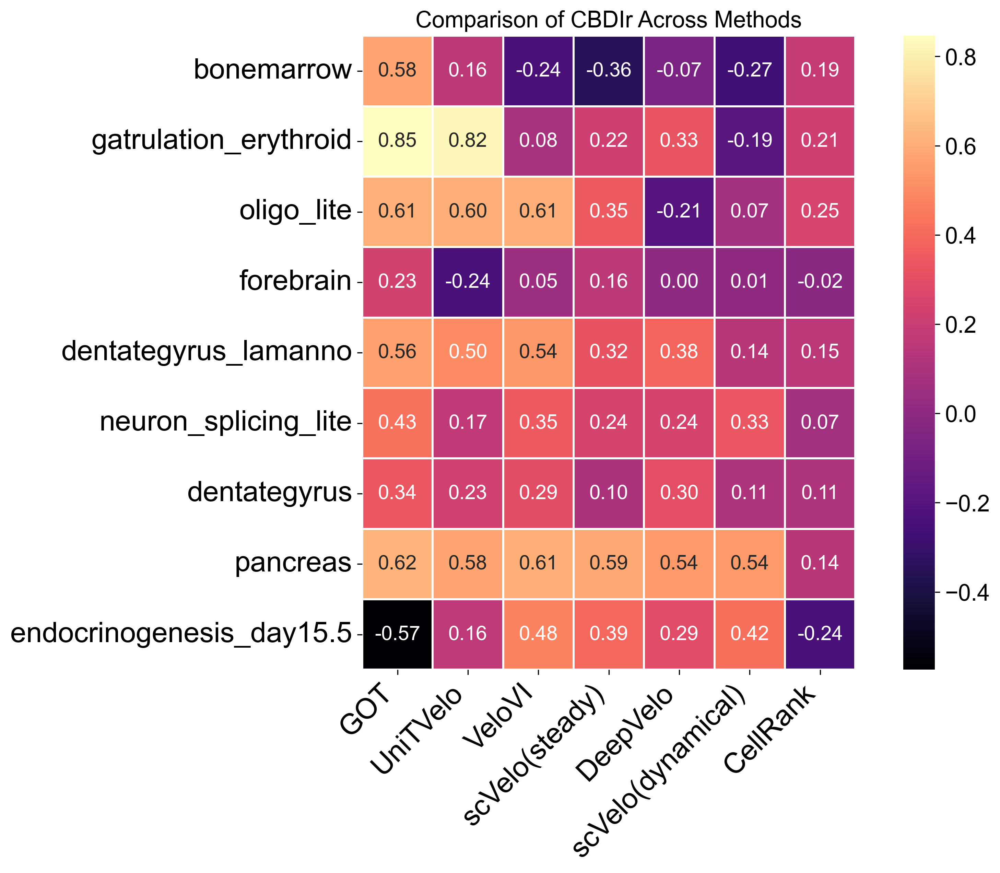

In [105]:
order = (CBDir_matrix['GOT'] - CBDir_matrix[CBDir_matrix.columns[1:]].mean(axis=1)).sort_values(ascending=False).index
fig, ax = plt.subplots(1,1,figsize=(12, 8), dpi=300)
sns.heatmap(CBDir_matrix.loc[order], cmap="magma", square=True, linecolor='white', linewidths=1, ax=ax, annot=True,annot_kws={'fontsize':14}, fmt=".2f")
plt.xlabel("", fontsize=14) 
plt.ylabel("", fontsize=14)  

plt.xticks(rotation=45, ha='right', fontsize=20, color='black') 
plt.yticks(fontsize=20, color='black')
plt.title("Comparison of CBDIr Across Methods", fontsize=16) 



In [106]:
def plot_ot_mst(adata, mst_children, basis='umap', color=None, ax=None):
        data = adata.obsm['X_' + basis]
        cluster_labels = adata.obs['int_cluster'].to_numpy()
        cluster_centres = calculate_cluster_centres(data, cluster_labels)
        if ax is None:
            fig, ax = plt.subplots(1, 1, )
        sc.pl.embedding(adata, basis=basis, ax=ax, show=False, color=color, frameon=False)
        start_node_indicator = np.array([True for i in range(len(mst_children)) ])
        for root, kids in mst_children.items():
            for child in kids:
                start_node_indicator[child] = False
                x_coords = [cluster_centres[root][0], cluster_centres[child][0]]
                y_coords = [cluster_centres[root][1], cluster_centres[child][1]]
                ax.plot(x_coords, y_coords, 'k-')

        


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):


/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(v

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(v

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(v

/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/disk/xuruihong/miniconda3/envs/got/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(v

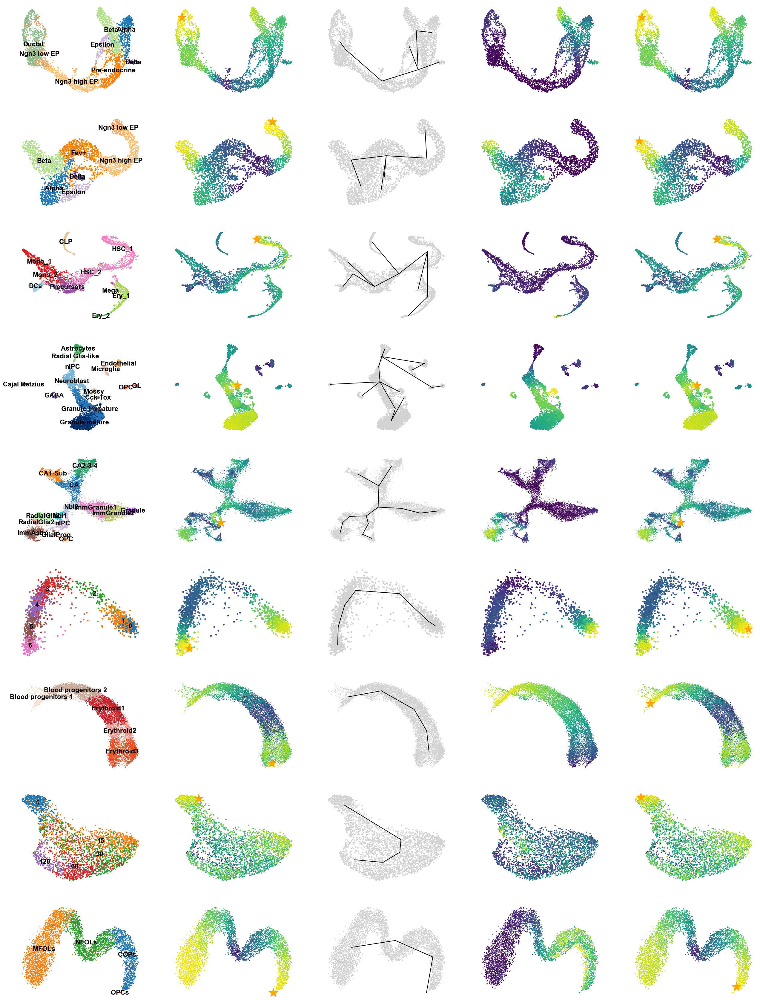

In [107]:
from pygot.tools.traj.mst import topological_tree
fig, axes = plt.subplots(9, 5, figsize=(6.4 * 5, 4.8 * 9))
for axi, i in enumerate([0,6,1,2,3,4,5,7,8]):
    sc.pl.embedding(adatas[i], color=colors[i], colorbar_loc=None, title='', frameon=False, ax=axes[axi][0], basis=vis_keys[i], show=False, legend_loc='on data')
    sc.pl.embedding(adatas[i], color='root_score', colorbar_loc=None, title='', frameon=False, ax=axes[axi][1], basis=vis_keys[i], show=False)
    adatas[i].uns['ot_root'] = adatas[i].obs['root_score'].to_numpy().argmax()
    adatas[i].uns['iroot'] = adatas[i].uns['ot_root']
    sc.tl.dpt(adatas[i])
    ot_tree, _, _ = topological_tree(adatas[i], embedding_key='X_pca', cell_type_key=colors[i], time_key='dpt_pseudotime',  start_cell_type=adatas[i].obs[colors[i]].tolist()[adatas[i].uns['ot_root']])
    plot_ot_mst(adatas[i], ot_tree,  basis=vis_keys[i], ax=axes[axi][2] )
    sc.pl.embedding(adatas[i], color='ct_score', colorbar_loc=None, title='', frameon=False, ax=axes[axi][3], basis=vis_keys[i], show=False)
    sc.pl.embedding(adatas[i], color='ct_root_score', colorbar_loc=None, title='', frameon=False, ax=axes[axi][4], basis=vis_keys[i], show=False)
    root_point = adatas[i].obs['root_score'].to_numpy().argmax()
    axes[axi][1].scatter(adatas[i].obsm['X_'+vis_keys[i]][root_point,0], adatas[i].obsm['X_'+vis_keys[i]][root_point,1], marker='*', s=500, color='orange')
    root_point = adatas[i].obs['ct_root_score'].to_numpy().argmax()
    axes[axi][4].scatter(adatas[i].obsm['X_'+vis_keys[i]][root_point,0], adatas[i].obsm['X_'+vis_keys[i]][root_point,1], marker='*', s=500, color='orange')
#plt.savefig('/mnt/c//Users/Ruihong/Desktop/LiuLab/paper/figs/snapshot/source_scores.jpg', format='jpg', bbox_inches="tight", dpi=300)

In [ ]:
datasets = ['pancreas', 'bonemarrow', 'dentategyrus', 'dentategyrus_lamanno', 'forebrain','gatrulation_erythroid', 'endocrinogenesis_day15.5','neuron_splicing_lite','oligo_lite']
colors = ['clusters', 'clusters', 'clusters', 'clusters', 'Clusters', 'celltype', 'clusters', 'time', 'celltype']
methods = ['got', 'univelo', 'velovi',  'scvelo_steady',  'deepvelo', 'scvelo_dynamic', 'cellrank']
fig, axes = plt.subplots(len(datasets),len(methods), figsize=(6.4*len(methods), 4.8 * len(datasets)))
for axi, i in enumerate([0,6,1,2,3,4,5,7,8]):
    for j in range(len(methods)):
        try:
            velo = np.load('./results/06_snapshot/{}/{}_{}.npy'.format(datasets[i], methods[j], vis_keys[i]))
            adatas[i].obsm['velocity_{}'.format(vis_keys[i])] = velo
            legend_loc = 'none' 
            
            scv.pl.velocity_embedding_stream(
                adatas[i],
                basis=vis_keys[i],
                legend_loc=legend_loc,
                ax = axes[axi][j],
                color=colors[i],
                title='',
                show=False
            )
        except:
            axes[axi][j].axis("off")  # Disable axis to create a blank subplot
            continue

#plt.savefig('/mnt/c//Users/Ruihong/Desktop/LiuLab/paper/figs/snapshot/all_vector_fields.png', format='png', bbox_inches="tight")
#plt.close()

In [ ]:
datasets = ['pancreas', 'bonemarrow', 'dentategyrus', 'dentategyrus_lamanno', 'forebrain','gatrulation_erythroid', 'endocrinogenesis_day15.5','neuron_splicing_lite','oligo_lite']
colors = ['clusters', 'clusters', 'clusters', 'clusters', 'Clusters', 'celltype', 'clusters', 'time', 'celltype']
methods = ['got', 'velovi']
fig, axes = plt.subplots(3,2, figsize=(6.4*2, 4.8 * 3), dpi=300)
for pi, i in enumerate([0,1,3]):
    for j in range(len(methods)):
        try:
            velo = np.load('./results/06_snapshot/{}/{}_{}.npy'.format(datasets[i], methods[j], vis_keys[i]))
            adatas[i].obsm['velocity_{}'.format(vis_keys[i])] = velo
            legend_loc = 'none' if j != 0 else 'on data'
            
            scv.pl.velocity_embedding_stream(
                adatas[i],
                basis=vis_keys[i],
                legend_loc='none',
                ax = axes[pi][j],
                color=colors[i],
                title='',
                show=False
            )
        except:
            axes[pi][j].axis("off")  # Disable axis to create a blank subplot
            continue

plt.savefig('/mnt/c//Users/Ruihong/Desktop/LiuLab/paper/figs/snapshot/example_vector_fields.png', format='png', bbox_inches="tight")
plt.close()